In [2]:
import os
from glob import glob
from tqdm import tqdm
import cv2
import numpy as np
import pandas as pd
np.random.seed(2455)
import matplotlib.pyplot as plt

plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] =False

import albumentations as A
from albumentations.pytorch import ToTensorV2


## 이미지 Aug & Mix 복사

In [3]:
def save_img(path, img) :
    extension = ".png"#os.path.splitext(path)[1] # 이미지 확장자
    result, encoded_img = cv2.imencode(extension, img)
    
    if result:
        with open(path, mode='w+b') as f:
            encoded_img.tofile(f)

    
def load_img(path) :
    img_array = np.fromfile(path, np.uint8)
    img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
    return img
    # return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


## Aug 적용 전 데이터 개수

In [3]:
path = './data/train/*'
label_dict = []
for p in glob(path):
    label_name = p.split("\\")[-1]
    label_cnt = len([_p for _p in glob(p+"/*") if "_aug_" not in _p])
    label_dict.append([label_name, label_cnt])
    
label_dict = sorted(label_dict, key=lambda x:x[-1])
for k, v in label_dict :
    print(k + " : " + str(v))



반점 : 3
틈새과다 : 5
가구수정 : 12
녹오염 : 14
이음부불량 : 17
울음 : 22
창틀,문틀수정 : 27
피스 : 51
들뜸 : 54
석고수정 : 57
면불량 : 99
몰딩수정 : 130
오타공 : 142
곰팡이 : 145
터짐 : 162
꼬임 : 210
걸레받이수정 : 307
오염 : 595
훼손 : 1405


## Offline Augmentations

In [5]:
from albumentations.core.transforms_interface import ImageOnlyTransform
class MixedEdgeImage(ImageOnlyTransform):
    def __init__(
        self,
        alpha=0.3,
        beta=0.7,
        always_apply=False,
        p=1
    ):
        super(MixedEdgeImage, self).__init__(always_apply, p)
        self.alpha = alpha
        self.beta = beta
        
    def apply(self, img, **params):
        return self.mixed_edge_image(img)
    
    def mixed_edge_image(self, img) :
        canny_img = cv2.Canny(img, 100, 200, apertureSize=7)
        empty_img = np.zeros((canny_img.shape[0], canny_img.shape[1], 3))
        for i in range(3):
            empty_img[:,:,i] = canny_img
        return np.uint8(empty_img *self.alpha + img * self.beta)
    
    def get_transform_init_args_names(self):
        return ("alpha", "beta")

### 반점
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [78]:
# second ====================
# transforms = A.Compose([
#     A.Rotate(p=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
#     A.RandomGridShuffle((4,4)),
#     A.ColorJitter(),
#     A.RandomSunFlare(src_radius=100),
#     A.ToGray(p=0.5),
#     A.ToSepia(),
#     # A.GridDistortion(),
#     MixedEdgeImage(alpha=0.1, beta=0.9, p=0.3),
#     A.ElasticTransform(p=1, 
#                     alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
#     # A.Perspective(p=1),
#     # A.Spatter(intensity=0.3, p=1)
# ])

# first ==============
transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.RandomGridShuffle(),
    A.ColorJitter(),
    A.RandomSunFlare(src_radius=200),
    A.ToGray(p=0.5),
    # A.ToSepia(),
    A.GridDistortion(),
    A.Perspective(p=1),
    # A.Spatter(intensity=0.3, p=1)
])

##### augmentations 180장

In [90]:
# path = "./data/train/반점/*"
# img_list = glob(path)
path = './data/more_first_aug_train/*'
curr_label = "반점"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]
num_aug = 160 # 80
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list :
        img = load_img(p)
        img = transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        # cv2.imwrite(save_path, img)
        save_img(save_path, img)
        
        


100%|██████████| 160/160 [00:14<00:00, 11.18it/s]


##### mixup 162장
- 각 클래스에서 3장씩 샘플링

In [37]:
# transforms = A.Compose([
#     A.Rotate(p=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
#     A.ColorJitter(),
# ])

In [38]:
# path = './data/train/*'
# curr_label = "반점"
# num_sample = 3

# folder_list = [p for p in glob(path) if curr_label not in p]
# smapling_img_list = []
# for idx, f in enumerate(folder_list) :
#     img_list = glob(os.path.join(f, '*'))
#     sampling = np.random.choice(len(img_list), num_sample, replace=False)
#     smapling_img_list.extend(np.array(img_list)[sampling].tolist())

In [40]:
# curr_img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
# for s_idx, sampling_img_path in enumerate(tqdm(smapling_img_list)) :
#     for c_idx, curr_img_path in enumerate(curr_img_list) :
#         samp_img = load_img(sampling_img_path)
#         curr_img = transforms(image=load_img(curr_img_path))['image']
        
#         samp_img = cv2.resize(samp_img, (600, 600))
#         curr_img = cv2.resize(curr_img, (600, 600))
        
#         img = cv2.addWeighted(curr_img, 0.85, samp_img, 0.15, 0)
        
#         save_path = os.path.join(curr_img_path.split('\\')[-2], str(s_idx) + "_mix_" + curr_img_path.split("\\")[-1])
        
#         save_img(save_path, img)

100%|██████████| 54/54 [00:04<00:00, 12.19it/s]


### 틈새과다
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [91]:
# second ==================
# aug_transforms = A.Compose([
#     # A.Rotate(p=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
#     A.GlassBlur(),
#     A.OneOf([
#         A.ToGray(p=0.5),
#         A.ColorJitter(),
#         A.ChannelShuffle(),            
#     ], p=1),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=0.1),
    
#     A.Affine(p=1, fit_output=True, mask_interpolation=1, mode=1),
#     A.ElasticTransform(p=0.7, 
#                     alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
#     # A.GridDistortion(),
#     # A.Perspective(p=1),
#     # A.RandomCrop(height=550, width=500, p=1)
#     A.RandomShadow(p=0.5),    
# ])

# mix_transforms = A.Compose([
#     A.Rotate(p=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
#     A.ColorJitter(),
# ])

# first ============
aug_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.GlassBlur(),
    A.ColorJitter(),
    A.ChannelShuffle(),
    A.FancyPCA(p=0.1),
    A.ToGray(p=0.5),
    A.Emboss(),
    A.GridDistortion(),
    A.Perspective(p=1),
    A.RandomShadow(p=0.3),    
    A.RandomCrop(height=550, width=500, p=1)
])


##### augmentation 200장

In [92]:
# path = "./data/train/틈새과다/*"
# img_list = glob(path)

path = "./data/more_first_aug_train/*"
curr_label = "틈새과다"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 110 # 55
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
        # plt.imshow(img)
    
        save_img(save_path, img)
        
        


100%|██████████| 110/110 [00:33<00:00,  3.32it/s]


##### mixup 180장
- 각 클래스에서 2장씩 샘플링

In [258]:
# path = './data/train/*'
# curr_label = "틈새과다"
# num_sample = 2

# folder_list = [p for p in glob(path) if curr_label not in p]
# smapling_img_list = []
# for idx, f in enumerate(folder_list) :
#     img_list = glob(os.path.join(f, '*'))
#     sampling = np.random.choice(len(img_list), num_sample, replace=False)
#     smapling_img_list.extend(np.array(img_list)[sampling].tolist())

In [259]:
# curr_img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
# for s_idx, sampling_img_path in enumerate(tqdm(smapling_img_list)) :
#     for c_idx, curr_img_path in enumerate(curr_img_list) :
#         samp_img = load_img(sampling_img_path)
#         curr_img = transforms(image=load_img(curr_img_path))['image']
        
#         samp_img = cv2.resize(samp_img, (600, 600))
#         curr_img = cv2.resize(curr_img, (600, 600))
        
#         img = cv2.addWeighted(curr_img, 0.7, samp_img, 0.3, 0)
        
#         save_path = os.path.join(curr_img_path.split('\\')[-2], str(s_idx) + "_mix_" + curr_img_path.split("\\")[-1])
        
#         save_img(save_path, img)
        

100%|██████████| 36/36 [00:05<00:00,  7.12it/s]


### 가구수정 
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [94]:
# second ====================
# aug_transforms = A.Compose([
#     # A.Resize(600, 600, p=1),
#     # A.Rotate(p=1),
#     A.Affine(p=0.6, fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),            
#     ], p=1),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=0.1),
    
#     A.Affine(p=0.6, rotate=(-60, 60), fit_output=True, mask_interpolation=1, mode=1),

#     A.ElasticTransform(p=1, 
#                 alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     # A.GlassBlur(),
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.FancyPCA(p=0.1),
#     # A.ToGray(p=0.5),
#     A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(),
#     # A.Perspective(p=1),
#     A.RandomShadow(p=0.3),    
#     # A.RandomCrop(height=550, width=500, p=1)
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.ColorJitter(),
])

# first ===================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.GlassBlur(),
    # A.ColorJitter(),
    # A.ChannelShuffle(),
    # A.FancyPCA(p=0.1),
    # A.ToGray(p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    # A.GridDistortion(),
    A.Perspective(p=1),
    A.RandomShadow(p=0.3),    
    A.RandomCrop(height=550, width=500, p=1)
])

##### augmentation 120장
- 각 클래스에서 3장씩 샘플링

In [9]:
# path = "./data/train/가구수정/*"
# img_list = glob(path)

# path = "./data/train/*"
# curr_label = "가구수정"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "가구수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]


num_aug = 50 # 25
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
        # plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


Traceback (most recent call last):
  File "_pydevd_bundle/pydevd_cython.pyx", line 1081, in _pydevd_bundle.pydevd_cython.PyDBFrame.trace_dispatch
  File "_pydevd_bundle/pydevd_cython.pyx", line 297, in _pydevd_bundle.pydevd_cython.PyDBFrame.do_wait_suspend
  File "c:\Users\quhb2\Anaconda3\envs\torch-1.11\lib\site-packages\debugpy\_vendored\pydevd\pydevd.py", line 2023, in do_wait_suspend
    keep_suspended = self._do_wait_suspend(thread, frame, event, arg, suspend_type, from_this_thread, frames_tracker)
  File "c:\Users\quhb2\Anaconda3\envs\torch-1.11\lib\site-packages\debugpy\_vendored\pydevd\pydevd.py", line 2059, in _do_wait_suspend
    time.sleep(0.01)
KeyboardInterrupt


KeyboardInterrupt: 

##### mixup 216장
- 각 클래스에서 1장씩 샘플링

In [572]:
# path = './data/train/*'
# curr_label = "가구수정"
# num_sample = 1

# folder_list = [p for p in glob(path) if curr_label not in p]
# smapling_img_list = []
# for idx, f in enumerate(folder_list) :
#     img_list = glob(os.path.join(f, '*'))
#     sampling = np.random.choice(len(img_list), num_sample, replace=False)
#     smapling_img_list.extend(np.array(img_list)[sampling].tolist())
    
# curr_img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
# for s_idx, sampling_img_path in enumerate(tqdm(smapling_img_list)) :
#     for c_idx, curr_img_path in enumerate(curr_img_list) :
#         samp_img = load_img(sampling_img_path)
#         curr_img = transforms(image=load_img(curr_img_path))['image']
        
#         samp_img = cv2.resize(samp_img, (600, 600))
#         curr_img = cv2.resize(curr_img, (600, 600))
        
#         img = cv2.addWeighted(curr_img, 0.8, samp_img, 0.2, 0)
        
#         save_path = os.path.join(curr_img_path.split('\\')[-2], str(s_idx) + "_mix_" + curr_img_path.split("\\")[-1])
        
#         save_img(save_path, img)
        

100%|██████████| 18/18 [00:05<00:00,  3.24it/s]


### 녹오염 
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [96]:
# second ======================
# aug_transforms = A.Compose([
#     # A.Resize(600, 600, p=1),
#     # A.Rotate(p=1),
#     A.Affine(p=0.6, rotate=(-90, 90), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),

#     A.GlassBlur(),

#     # A.OneOf([
#     #     A.ToGray(),
#     #     A.ColorJitter(),
#     #     A.ChannelShuffle(),            
#     # ], p=1),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    

#     A.ElasticTransform(p=1, 
#                 alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    

#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     A.RandomGridShuffle((4,4), p=0.5),
#     # A.ToGray(p=0.5),
#     A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     A.Perspective(p=0.5),
#     A.RandomShadow(p=0.3),    
    
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
])

# first ======================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.GlassBlur(),
    # A.ColorJitter(),
    # A.ChannelShuffle(),
    A.RandomGridShuffle((2,2), p=1),
    # A.ToGray(p=0.5),
    # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    # A.GridDistortion(p=1),
    A.Perspective(p=1),
    A.RandomShadow(p=0.3),    
    A.RandomCrop(height=570, width=570, p=1)
])


##### augmentations 112장

In [97]:
# path = "./data/train/녹오염/*"
# img_list = glob(path)

# path = "./data/train/*"
# curr_label = "녹오염"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "녹오염"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 35 #16
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
        # plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 35/35 [00:26<00:00,  1.34it/s]


##### mixup 252장
- 각 클래스에서 3장씩 샘플링

In [896]:
# path = './data/train/*'
# curr_label = "녹오염"
# num_sample = 1

# folder_list = [p for p in glob(path) if curr_label not in p]
# smapling_img_list = []
# for idx, f in enumerate(folder_list) :
#     img_list = glob(os.path.join(f, '*'))
#     sampling = np.random.choice(len(img_list), num_sample, replace=False)
#     smapling_img_list.extend(np.array(img_list)[sampling].tolist())
    
# curr_img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
# for s_idx, sampling_img_path in enumerate(tqdm(smapling_img_list)) :
#     for c_idx, curr_img_path in enumerate(curr_img_list) :
#         samp_img = load_img(sampling_img_path)
#         curr_img = mix_transforms(image=load_img(curr_img_path))['image']
        
#         samp_img = cv2.resize(samp_img, (600, 600))
#         curr_img = cv2.resize(curr_img, (600, 600))
        
#         img = cv2.addWeighted(curr_img, 0.7, samp_img, 0.3, 0)
        
#         save_path = os.path.join(curr_img_path.split('\\')[-2], str(s_idx) + "_mix_" + curr_img_path.split("\\")[-1])
        
#         save_img(save_path, img)
        

100%|██████████| 18/18 [00:06<00:00,  2.79it/s]


### 이음부불량 
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [98]:
# second ========================
# aug_transforms = A.Compose([
#     # A.Resize(600, 600, p=1),
#     A.Affine(p=0.6, rotate=(-30, 30), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
#     # A.GlassBlur(),
        
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     A.OneOf([
#         # A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#     ], p=1),


#     # A.RandomGridShuffle((2,2), p=1),
#     # A.ToGray(p=0.5),
#     A.ElasticTransform(p=1, 
#                 alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False,p=1),   
#         A.Posterize(num_bits=3, p=0.3)
#     ], p=1)
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.3),    
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(p=1)
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first ====================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.GlassBlur(),
    A.ColorJitter(),
    A.ChannelShuffle(),
    # A.RandomGridShuffle((2,2), p=1),
    A.ToGray(p=0.5),
    A.ToSepia(p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    # A.GridDistortion(p=1),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.3),    
    A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(p=1)
])


##### mixup 162장m
- 각 클래스에서 3장씩 샘플링

In [99]:
# path = "./data/train/이음부불량/*"
# img_list = glob(path)

# path = "./data/train/*"
# curr_label = "이음부불량"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
path = "./data/more_first_aug_train/*"
curr_label = "이음부불량"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 33 #18
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list[1:]:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 33/33 [00:10<00:00,  3.02it/s]


##### mixup 306장
- 각 클래스에서 1장씩 샘플링

In [984]:
# path = './data/train/*'
# curr_label = "이음부불량"
# num_sample = 1

# folder_list = [p for p in glob(path) if curr_label not in p]
# smapling_img_list = []
# for idx, f in enumerate(folder_list) :
#     img_list = glob(os.path.join(f, '*'))
#     sampling = np.random.choice(len(img_list), num_sample, replace=False)
#     smapling_img_list.extend(np.array(img_list)[sampling].tolist())
    
# curr_img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
# for s_idx, sampling_img_path in enumerate(tqdm(smapling_img_list)) :
#     for c_idx, curr_img_path in enumerate(curr_img_list) :
#         samp_img = load_img(sampling_img_path)
#         curr_img = mix_transforms(image=load_img(curr_img_path))['image']
        
#         samp_img = cv2.resize(samp_img, (600, 600))
#         curr_img = cv2.resize(curr_img, (600, 600))
        
#         img = cv2.addWeighted(curr_img, 0.8, samp_img, 0.2, 0)
        
#         save_path = os.path.join(curr_img_path.split('\\')[-2], str(s_idx) + "_mix_" + curr_img_path.split("\\")[-1])
        
#         save_img(save_path, img)
        

100%|██████████| 18/18 [00:07<00:00,  2.36it/s]


### 울음
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [100]:
# second =========================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-90, 90), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
#     # A.GlassBlur(),
        
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     A.Spatter(intensity=0.2, p=0.5),
    
#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),
    
#     # A.GlassBlur(),
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.RandomGridShuffle((2,2), p=1),
#     # A.ToGray(p=0.5),
#     # A.ToSepia(p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.3),    
#     # A.Equalize(by_channels=False,p=0.3),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=4, p=1),
#     A.RandomShadow(p=0.7),
#     # A.ElasticTransform(p=1, 
#     #         alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=1)
    
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first =========================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.GlassBlur(),
    A.ColorJitter(),
    A.ChannelShuffle(),
    # A.RandomGridShuffle((2,2), p=1),
    A.ToGray(p=0.5),
    A.ToSepia(p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    # A.GridDistortion(p=1),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.3),    
    A.Equalize(by_channels=False,p=0.3),
    # A.RGBShift(p=1),
    A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
])

##### augmentation 220장
- 각 클래스에서 3장씩 샘플링

In [101]:
# path = "./data/train/울음/*"
# img_list = glob(path)

# path = "./data/train/*"
# curr_label = "울음"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
path = "./data/more_first_aug_train/*"
curr_label = "울음"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 33 #16
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 33/33 [00:19<00:00,  1.71it/s]


##### mixup 220장
- 각 클래스에서 3장씩 샘플링

In [1224]:
# path = './data/train/*'
# curr_label = "울음"
# num_sample = 1

# folder_list = [p for p in glob(path) if curr_label not in p]
# smapling_img_list = []
# for idx, f in enumerate(folder_list) :
#     if np.random.binomial(n=1, p=0.5, size=1)[0] :
#         img_list = glob(os.path.join(f, '*'))
#         sampling = np.random.choice(len(img_list), num_sample, replace=False)
#         smapling_img_list.extend(np.array(img_list)[sampling].tolist())
    
# curr_img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]
# for s_idx, sampling_img_path in enumerate(tqdm(smapling_img_list)) :
#     for c_idx, curr_img_path in enumerate(curr_img_list) :
#         samp_img = load_img(sampling_img_path)
#         curr_img = mix_transforms(image=load_img(curr_img_path))['image']
        
#         samp_img = cv2.resize(samp_img, (600, 600))
#         curr_img = cv2.resize(curr_img, (600, 600))
        
#         img = cv2.addWeighted(curr_img, 0.85, samp_img, 0.15, 0)
        
#         save_path = os.path.join(curr_img_path.split('\\')[-2], str(s_idx) + "_mix_" + curr_img_path.split("\\")[-1])
        
#         save_img(save_path, img)
        

100%|██████████| 10/10 [00:05<00:00,  1.87it/s]


### 창틀,문틀수정
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [102]:
# second ===================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
#     # A.GlassBlur(),
        
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     # A.Spatter(intensity=0.2, p=0.5),
    
#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),
    
#     A.RandomShadow(p=0.7),
#     A.RandomSunFlare(src_radius=50, p=0.4),
    
#     A.ElasticTransform(p=1, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),

#     # A.Blur(p=0.5),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=1)
    
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.RandomGridShuffle((2,2), p=1),
#     # A.ToGray(p=0.5),
#     # A.ToSepia(p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=0.5),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.3),    
#     # A.Equalize(by_channels=False,p=0.3),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first ========================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.Blur(),
    A.ColorJitter(),
    # A.ChannelShuffle(),
    # A.RandomGridShuffle((2,2), p=1),
    # A.ToGray(p=0.5),
    A.ToSepia(p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=0.5),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.3),    
    # A.Equalize(by_channels=False,p=0.3),
    # A.RGBShift(p=1),
    A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
])

##### mixup 210장
- 각 클래스에서 3장씩 샘플링

In [103]:
# path = "./data/train/*"
# curr_label = "창틀,문틀수정"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "창틀,문틀수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 22# 15
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        



100%|██████████| 22/22 [00:15<00:00,  1.38it/s]


### 피스
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [104]:
# second =====================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     # A.GlassBlur(),
    
#     A.Spatter(intensity=0.2, p=0.5),
    
#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),
    
#     A.RandomShadow(p=0.7),
#     # A.RandomSunFlare(src_radius=50, p=0.4),
    
#     A.ElasticTransform(p=1, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),

#     # A.Blur(p=0.5),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=1)
    
#     # A.Blur(),
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.RandomGridShuffle((2,2), p=1),
#     # A.ToGray(p=0.5),
#     # A.ToSepia(p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=0.5),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.3),    
#     # A.Equalize(by_channels=False,p=0.3),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first =========================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.Blur(),
    A.ColorJitter(),
    A.ChannelShuffle(),
    # A.RandomGridShuffle((2,2), p=1),
    A.ToGray(p=0.5),
    A.ToSepia(p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    # A.GridDistortion(p=0.5),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.3),    
    A.Equalize(by_channels=False,p=0.3),
    # A.RGBShift(p=1),
    # A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
])

##### mixup 255 장
- 각 클래스에서 3장씩 샘플링

In [105]:
# path = "./data/train/*"
# curr_label = "피스"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "피스"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 10 #5
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 10/10 [00:15<00:00,  1.55s/it]


### 들뜸
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [106]:
# second =======================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     # A.GlassBlur(),
#     A.OneOf([
#         A.Spatter(intensity=0.2),
#         MixedEdgeImage(alpha=0.1, beta=0.9)    
#     ], p=0.5),

#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),
    
        
#     A.ElasticTransform(p=0.5, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=0.4)
#     # A.Blur(),
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.RandomGridShuffle((2,2), p=1),
#     # A.ToGray(p=0.5),
#     # A.ToSepia(p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=0.5),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.3),    
#     # A.Equalize(by_channels=False,p=0.3),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first =====================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.Blur(),
    A.ColorJitter(),
    A.ChannelShuffle(),
    # A.RandomGridShuffle((2,2), p=1),
    A.ToGray(p=0.5),
    A.ToSepia(p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    # A.GridDistortion(p=0.5),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.3),    
    # A.Equalize(by_channels=False,p=0.3),
    # A.RGBShift(p=1),
    # A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
])

##### mixup 270 장
- 각 클래스에서 3장씩 샘플링

In [107]:
# path = "./data/train/*"
# curr_label = "들뜸"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "들뜸"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 10 #5
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 10/10 [00:13<00:00,  1.36s/it]


### 석고수정
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [108]:
# second =====================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     # A.GlassBlur(sigma=0.2, p=0.4),
    
#     A.OneOf([
#         A.Spatter(intensity=0.2),
#         MixedEdgeImage(alpha=0.1, beta=0.9)    
#     ], p=0.5),

#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),
    
        
#     A.ElasticTransform(p=0.5, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=0.4)
    
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.OneOf([
#     #     A.ToGray(p=0.5),
#     #     A.ToSepia(p=0.5)
#     # ],p=0.5),
#     # A.RandomGridShuffle((2,2), p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.5),    
#     # A.Equalize(by_channels=False,p=0.3),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first =====================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.Blur(),
    
    A.ColorJitter(),
    # A.ChannelShuffle(),
    A.OneOf([
        A.ToGray(p=0.5),
        A.ToSepia(p=0.5)
    ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=1),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.5),    
    # A.Equalize(by_channels=False,p=0.3),
    # A.RGBShift(p=1),
    # A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
])

##### mixup 285장
- 각 클래스에서 3장씩 샘플링b

In [109]:
# path = "./data/train/*"
# curr_label = "석고수정"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "석고수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 10 #5
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 10/10 [00:16<00:00,  1.69s/it]


### 면불량
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [110]:
# second ===========================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     # A.GlassBlur(sigma=0.2, p=0.4),
    
#     A.OneOf([
#         A.Spatter(intensity=0.2),
#         MixedEdgeImage(alpha=0.1, beta=0.9)    
#     ], p=0.5),

#     A.OneOf([
#         # A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),
    
        
#     A.ElasticTransform(p=0.5, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     # A.OneOf([
#     #     A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#     #     A.Posterize(num_bits=3),
#     #     A.Equalize(by_channels=False),
#     # ], p=0.4)
    
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.OneOf([
#     #     A.ToGray(p=0.5),
#     #     A.ToSepia(p=0.5)
#     # ],p=0.5),
#     # A.RandomGridShuffle((2,2), p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.5),    
#     # A.Equalize(by_channels=False,p=1),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first =====================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.Blur(),
    
    # A.ColorJitter(),
    # A.ChannelShuffle(),
    A.OneOf([
        A.ToGray(p=0.5),
        A.ToSepia(p=0.5)
    ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=1),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.5),    
    A.Equalize(by_channels=False,p=1),
    # A.RGBShift(p=1),
    # A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
])

##### mixup 198장
- 각 클래스에서 3장씩 샘플링

In [111]:
# path = "./data/train/*"
# curr_label = "면불량"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "면불량"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 5 #2
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 5/5 [00:15<00:00,  3.02s/it]


### 몰딩수정
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [112]:
# second ============================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     # A.GlassBlur(sigma=0.2, p=0.4),
    
#     A.OneOf([
#         A.Spatter(intensity=0.2),
#         MixedEdgeImage(alpha=0.1, beta=0.9)    
#     ], p=0.5),

#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),

#     A.RandomShadow(p=0.3),
#     A.RandomSunFlare(src_radius=50, p=0.3), 
    
#     A.ElasticTransform(p=0.5, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=0.4)
    
#     # A.ChannelShuffle(),
#     # A.OneOf([
#     #     A.ToGray(p=0.5),
#     #     A.ToSepia(p=0.5)
#     # ],p=0.5),
#     # A.RandomGridShuffle((2,2), p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.5),    
#     # A.Equalize(by_channels=False,p=1),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first ===================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.Blur(),
    
    A.ColorJitter(),
    # A.ChannelShuffle(),
    # A.OneOf([
    #     A.ToGray(p=0.5),
    #     A.ToSepia(p=0.5)
    # ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=1),
    A.Perspective(p=1),
    A.RandomShadow(p=0.5),    
    # A.Equalize(by_channels=False,p=1),
    # A.RGBShift(p=1),
    A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
])

##### mixup 130장
- 각 클래스에서 3장씩 샘플링

In [113]:
# path = "./data/train/*"
# curr_label = "몰딩수정"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]


path = "./data/more_first_aug_train/*"
curr_label = "몰딩수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 4 #1
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 4/4 [00:14<00:00,  3.74s/it]


### 오타공
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [114]:
# second ========================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
    
    
#     A.OneOf([
#         # A.Spatter(intensity=0.2),
#         MixedEdgeImage(alpha=0.1, beta=0.9)    
#     ], p=0.5),
    
#     A.Blur(p=0.4),
    
#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),

#     A.RandomShadow(p=0.3),
#     # A.RandomSunFlare(src_radius=50, p=0.3),
    
#     A.ElasticTransform(p=0.5, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=0.4)
    
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.OneOf([
#     #     A.ToGray(p=0.5),
#     #     A.ToSepia(p=0.5)
#     # ],p=0.5),
#     # A.RandomGridShuffle((2,2), p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.5),    
#     # A.Equalize(by_channels=False,p=1),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
#     # A.PiecewiseAffine(p=1)
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first ===============
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    A.Blur(),
    
    A.ColorJitter(),
    A.ChannelShuffle(),
    A.OneOf([
        A.ToGray(p=0.5),
        A.ToSepia(p=0.5)
    ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=1),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.5),    
    # A.Equalize(by_channels=False,p=1),
    # A.RGBShift(p=1),
    A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
    A.PiecewiseAffine(p=1)
])

##### mixup 126장
- 각 클래스에서 3장씩 샘플링

In [115]:
# path = "./data/train/*"
# curr_label = "오타공"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "오타공"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 4 #1
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list[16:]:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 4/4 [01:46<00:00, 26.53s/it]


### 곰팡이
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [116]:
# second ===================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     A.OneOf([
#         A.Spatter(intensity=0.2),
#         MixedEdgeImage(alpha=0.1, beta=0.9)    
#     ], p=0.5),
    
#     # A.Blur(p=0.4),
    
#     # A.OneOf([
#     #     A.ToGray(),
#     #     A.ColorJitter(),
#     #     A.ChannelShuffle(),      
#     #     A.ToSepia(),      
#     #     A.RGBShift(),
#     # ], p=1),

#     A.RandomShadow(p=0.3),
#     A.RandomSunFlare(src_radius=50, p=0.3),
    
#     A.ElasticTransform(p=0.5, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         # A.Posterize(num_bits=3),
#         # A.Equalize(by_channels=False),
#     ], p=0.4)
    
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.OneOf([
#         # A.ToGray(p=1),
#         # A.ToSepia(p=0.5)
#     # ],p=0.5),
#     # A.RandomGridShuffle((2,2), p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.5),    
#     # A.Equalize(by_channels=False,p=1),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
#     # A.PiecewiseAffine(p=1)
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# first =====================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.Blur(),
    
    # A.ColorJitter(),
    A.ChannelShuffle(),
    # A.OneOf([
        # A.ToGray(p=1),
        # A.ToSepia(p=0.5)
    # ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=1),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.5),    
    # A.Equalize(by_channels=False,p=1),
    # A.RGBShift(p=1),
    A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=1),
    # A.PiecewiseAffine(p=1)
])

##### mixup 145장
- 각 클래스에서 3장씩 샘플링

In [117]:
# path = "./data/train/*"
# curr_label = "곰팡이"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "곰팡이"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 4 #1
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 4/4 [00:15<00:00,  3.88s/it]


### 터짐
#### 적용 리스트
- 회전, 뒤집기, 그리드스플릿, 색반전, Mixup

In [126]:
# second ==========================
# aug_transforms = A.Compose([
#     A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
#     A.OneOf([
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#     ],p = 0.5),
    
#     A.Emboss(p=1),
#     A.Sharpen(p=1), 
#     A.FancyPCA(p=1),
    
#     # A.OneOf([
#     #     A.Spatter(intensity=0.2),
#     #     MixedEdgeImage(alpha=0.1, beta=0.9)    
#     # ], p=0.5),
    
#     # A.Blur(p=0.4),
    
#     A.OneOf([
#         A.ToGray(),
#         A.ColorJitter(),
#         A.ChannelShuffle(),      
#         A.ToSepia(),      
#         A.RGBShift(),
#     ], p=1),

#     # A.RandomShadow(p=0.3),
#     # A.RandomSunFlare(src_radius=50, p=0.3),
    
#     A.ElasticTransform(p=0.5, 
#             alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
#     A.OneOf([
#         A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
#         A.Posterize(num_bits=3),
#         A.Equalize(by_channels=False),
#     ], p=0.4)
    
#     # A.ColorJitter(),
#     # A.ChannelShuffle(),
#     # A.OneOf([
#         # A.ToGray(p=1),
#         # A.ToSepia(p=0.5)
#     # ],p=0.5),
#     # A.RandomGridShuffle((2,2), p=0.5),
#     # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
#     # A.GridDistortion(p=1),
#     # A.Perspective(p=1),
#     # A.RandomShadow(p=0.5),    
#     # A.Equalize(by_channels=False,p=1),
#     # A.RGBShift(p=1),
#     # A.RandomCrop(height=570, width=570, p=1),
#     # A.Posterize(num_bits=8, p=1),
#     # A.PiecewiseAffine(p=1)
# ])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])

# =first ======================
aug_transforms = A.Compose([
    A.Resize(600, 600, p=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.Blur(),
    
    # A.ColorJitter(),
    A.ChannelShuffle(),
    # A.OneOf([
        # A.ToGray(p=1),
        # A.ToSepia(p=0.5)
    # ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=1),
    A.Perspective(p=1),
    # A.RandomShadow(p=0.5),    
    A.Equalize(by_channels=False,p=0.5),# => p=1 에서 0.5로 수정
    # A.RGBShift(p=1),
    A.RandomCrop(height=570, width=570, p=1),
    A.Posterize(num_bits=8, p=0.5), # => p=1 에서 0.5로 수정
    # A.PiecewiseAffine(p=1)
])

##### mixup 162장
- 각 클래스에서 3장씩 샘플링

In [127]:
# path = "./data/train/*"
# curr_label = "터짐"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "터짐"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 3 #1
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 3/3 [00:13<00:00,  4.59s/it]


### 꼬임

In [124]:
aug_transforms = A.Compose([
    # A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    
    A.Emboss(p=1),
    A.Sharpen(p=1), 
    A.FancyPCA(p=1),
    
    # A.OneOf([
    #     A.Spatter(intensity=0.2),
    #     MixedEdgeImage(alpha=0.1, beta=0.9)    
    # ], p=0.5),
    
    # A.Blur(p=0.4),
    
    A.OneOf([
        A.ToGray(),
        A.ColorJitter(),
        A.ChannelShuffle(),      
        A.ToSepia(),      
        A.RGBShift(),
    ], p=1),

    A.RandomShadow(p=0.3),
    A.RandomSunFlare(src_radius=50, p=0.3),
    
    A.ElasticTransform(p=0.5, 
            alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
        A.Posterize(num_bits=3),
        A.Equalize(by_channels=False),
    ], p=0.4),
    
    # A.ColorJitter(),
    # A.ChannelShuffle(),
    # A.OneOf([
        # A.ToGray(p=1),
        # A.ToSepia(p=0.5)
    # ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=0.3),
    # A.Perspective(p=1),
    # A.RandomShadow(p=0.5),    
    # A.Equalize(by_channels=False,p=1),
    # A.RGBShift(p=1),
    # A.RandomCrop(height=570, width=570, p=1),
    # A.Posterize(num_bits=8, p=1),
    # A.PiecewiseAffine(p=1)
])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])






In [125]:
# path = "./data/combine_train/*"
# curr_label = "꼬임"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*'))]#if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "꼬임"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 2
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 2/2 [00:46<00:00, 23.09s/it]


### 걸레받이 수정

In [128]:
aug_transforms = A.Compose([
    A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    
    A.Emboss(p=1),
    A.Sharpen(p=1), 
    A.FancyPCA(p=1),
    
    # A.OneOf([
    #     A.Spatter(intensity=0.2),
    #     MixedEdgeImage(alpha=0.1, beta=0.9)    
    # ], p=0.5),
    
    # A.Blur(p=0.4),
    
    A.OneOf([
        A.ToGray(),
        A.ColorJitter(),
        A.ChannelShuffle(),      
        A.ToSepia(),      
        A.RGBShift(),
    ], p=1),

    A.RandomShadow(p=0.3),
    A.RandomSunFlare(src_radius=50, p=0.3),
    
    A.ElasticTransform(p=0.5, 
            alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
        A.Posterize(num_bits=3),
        A.Equalize(by_channels=False),
    ], p=0.4),
    
    # A.ColorJitter(),
    # A.ChannelShuffle(),
    # A.OneOf([
        # A.ToGray(p=1),
        # A.ToSepia(p=0.5)
    # ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=0.3),
    A.Perspective(p=0.5),
    # A.RandomShadow(p=0.5),    
    # A.Equalize(by_channels=False,p=1),
    # A.RGBShift(p=1),
    # A.RandomCrop(height=570, width=570, p=1),
    # A.Posterize(num_bits=8, p=1),
    # A.PiecewiseAffine(p=1)
])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])



In [129]:
# path = "./data/combine_train/*"
# curr_label = "걸레받이수정"
# img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*'))]#if "_" not in i]

path = "./data/more_first_aug_train/*"
curr_label = "걸레받이수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


100%|██████████| 1/1 [00:51<00:00, 51.30s/it]


### 오염

In [ ]:
aug_transforms = A.Compose([
    A.Affine(p=0.6, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    
    A.Emboss(p=1),
    A.Sharpen(p=1), 
    A.FancyPCA(p=1),
    
    A.OneOf([
        A.Spatter(intensity=0.2),
        MixedEdgeImage(alpha=0.1, beta=0.9)    
    ], p=0.5),
    
    # A.Blur(p=0.4),
    
    A.OneOf([
        A.ToGray(),
        A.ColorJitter(),
        A.ChannelShuffle(),      
        A.ToSepia(),      
        A.RGBShift(),
    ], p=1),

    A.RandomShadow(p=0.3),
    A.RandomSunFlare(src_radius=50, p=0.3),
    
    A.ElasticTransform(p=0.5, 
            alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False),   
        A.Posterize(num_bits=3),
        A.Equalize(by_channels=False),
    ], p=0.4),
    
    # A.ColorJitter(),
    # A.ChannelShuffle(),
    # A.OneOf([
        # A.ToGray(p=1),
        # A.ToSepia(p=0.5)
    # ],p=0.5),
    # A.RandomGridShuffle((2,2), p=0.5),
    # A.RandomBrightnessContrast(brightness_by_max=False,p=1),
    A.GridDistortion(p=0.3),
    # A.Perspective(p=1),
    # A.RandomShadow(p=0.5),    
    # A.Equalize(by_channels=False,p=1),
    # A.RGBShift(p=1),
    # A.RandomCrop(height=570, width=570, p=1),
    # A.Posterize(num_bits=8, p=1),
    # A.PiecewiseAffine(p=1)
])

mix_transforms = A.Compose([
    A.Rotate(p=1),
    A.OneOf([
        A.HorizontalFlip(),
        A.VerticalFlip(),
    ],p = 0.5),
    # A.ColorJitter(),
    A.Posterize(p=1),

])



In [ ]:
path = "./data/combine_train/*"
curr_label = "오염"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*'))]#if "_" not in i]

num_aug = 1
for idx, n in enumerate(tqdm(range(num_aug))) :
    for p in img_list:
    
        img = load_img(p)
        img = aug_transforms(image=img)['image']
        
        save_path = os.path.join(p.split('\\')[-2], str(idx) + "_aug_" + p.split("\\")[-1])
        
    #     plt.imshow(img)
    #     break
    # break
        save_img(save_path, img)
        
        


### Aug 적용 후 데이터 개수

In [130]:
path = './data/more_first_aug_train/*'
glob(path)
label_dict = []
for p in glob(path):
    label_name = p.split("\\")[-1]
    label_cnt = len(glob(p+"/*"))
    label_dict.append([label_name, label_cnt])
    
total = 0
label_dict = sorted(label_dict, key=lambda x:x[-1])
for k, v in label_dict :
    print(k + " : " + str(v))
    total += v
print("TOTAL : ", total)


반점 : 483
녹오염 : 504
이음부불량 : 545
틈새과다 : 555
피스 : 561
들뜸 : 594
면불량 : 594
오염 : 595
가구수정 : 612
걸레받이수정 : 614
창틀,문틀수정 : 621
석고수정 : 627
꼬임 : 630
오타공 : 646
터짐 : 648
몰딩수정 : 650
곰팡이 : 725
울음 : 748
훼손 : 1405
TOTAL :  12357


## 실험 시각화 코드

In [3]:
def aug(transforms) :
    path = './data/train/*'
    folder_list = glob(path)
    f, axs = plt.subplots(len(folder_list), 1, figsize=(10, 70))
    axs = axs.flatten()
    num_sample = 1
    smapling_img_list = []
    for idx, f in enumerate(folder_list) :
        img_list = [p for p in glob(os.path.join(f, '*')) if "_aug_" not in p]
        sampling = np.random.choice(len(img_list), num_sample, replace=False)
        smapling_img_list.extend(np.array(img_list)[sampling].tolist())

    for idx ,p in enumerate(smapling_img_list) :
        img_array = np.fromfile(p, np.uint8)
        img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
        # img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)
        img = transforms(image=img)['image']
        axs[idx].imshow(img)
        axs[idx].set_title(p.split('\\')[-2])
        

    plt.show()


## Augmentation 실험 - edge detection

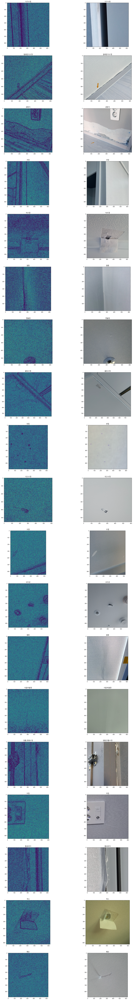

In [64]:
def aug(transforms) :
    path = './data/train/*'
    folder_list = glob(path)
    f, axs = plt.subplots(len(folder_list), 2, figsize=(20, 140))
    # axs = axs.flatten()
    num_sample = 1
    smapling_img_list = []
    for idx, f in enumerate(folder_list) :
        img_list = [p for p in glob(os.path.join(f, '*')) if "_aug_" not in p]
        sampling = np.random.choice(len(img_list), num_sample, replace=False)
        smapling_img_list.extend(np.array(img_list)[sampling].tolist())

    for idx ,p in enumerate(smapling_img_list) :
        img_array = np.fromfile(p, np.uint8)
        _ori_img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
        ori_img = cv2.cvtColor(_ori_img, cv2.COLOR_BGRA2RGB)
        
        canny_img = cv2.Canny(_ori_img, 100, 200, apertureSize=7)
        # print(canny_img.shape)
        # print(canny_img)
        # sobel_img = cv2.Sobel(ori_img, -1, 0, 1, ksize=7, scale=5, delta=0)
        # print(sobel_img.shape)
        # print(sobel_img)
        # empy_img = np.zeros((sobel_img.shape))
        
        # img = np.stack([canny_img, sobel_img, empy_img], axis=2)
        # img = cv2.cvtColor(img.astype(np.uint8), cv2.COLOR_BGR2GRAY)
        
        # img = transforms(image=img)['image']
        # print(img)
        # break
        axs[idx][0].imshow(canny_img)
        axs[idx][0].set_title(p.split('\\')[-2])
        axs[idx][1].imshow(_ori_img)
        axs[idx][1].set_title(p.split('\\')[-2])

    plt.show()

aug(None)

## Augmentation 실험 - SAM 사용

In [216]:
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)
    polygons = []
    color = []
    for ann in sorted_anns:
        m = ann['segmentation']
        img = np.ones((m.shape[0], m.shape[1], 3))
        # color_mask = np.random.random((1, 3)).tolist()[0]
        color_mask = np.full((1, 3), 255).tolist()[0]
        for i in range(3):
            img[:,:,i] = color_mask[i]
        ax.imshow(np.dstack((img, m*0.35)))
        
def add_anns(anns, ori):
    if len(anns) == 0:
        return ori
    
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ori = np.zeros((ori.shape[0], ori.shape[1], 3))
    
    for ann in sorted_anns:
        m = ann['segmentation']
        img = np.zeros((m.shape[0], m.shape[1], 3))
        for i in range(3):
            img[:,:,i] = m * 0.35
        ori = np.add(ori, img)
    return ori

In [222]:
from segment_anything import SamPredictor, sam_model_registry, SamAutomaticMaskGenerator
img = cv2.imread("./test.png")
img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)

sam = sam_model_registry["vit_b"](checkpoint="./sam_vit_b_01ec64.pth")
sam.to("cuda")
# mask_generator  = SamAutomaticMaskGenerator(sam)
mask_generator  = SamAutomaticMaskGenerator(model=sam,
    points_per_side=64,
    pred_iou_thresh=0.50,
    stability_score_thresh=0.80,
    crop_n_layers=1,
    crop_n_points_downscale_factor=2,
    min_mask_region_area=10)
# masks = mask_generator.generate(img)
# predictor.set_image(img)
# masks, _, _ = predictor.predict()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

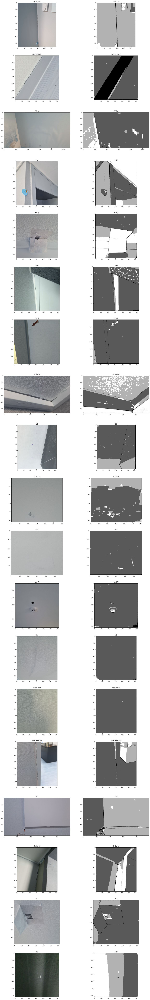

In [223]:
path = './data/train/*'
folder_list = glob(path)
f, axs = plt.subplots(len(folder_list), 2, figsize=(20, 140))
# axs = axs.flatten()
num_sample = 1
smapling_img_list = []
for idx, f in enumerate(folder_list) :
    img_list = [p for p in glob(os.path.join(f, '*')) if "_aug_" not in p]
    sampling = np.random.choice(len(img_list), num_sample, replace=False)
    smapling_img_list.extend(np.array(img_list)[sampling].tolist())

for idx ,p in enumerate(smapling_img_list) :
    img_array = np.fromfile(p, np.uint8)
    _ori_img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
    ori_img = cv2.cvtColor(_ori_img, cv2.COLOR_BGRA2RGB)
    
    masks = mask_generator.generate(ori_img)
    z = add_anns(masks, ori_img)
    # print(type(z))
    # print(type(ori_img))
    # print(ori_img)
    ori_img=cv2.addWeighted(ori_img.astype(np.uint8), 0.2, z.astype(np.uint8), 0.8, 0)
    # img = transforms(image=img)['image']
    # print(img)
    # break
    axs[idx][0].imshow(_ori_img)
    axs[idx][0].set_title(p.split('\\')[-2])
    
    axs[idx][1].imshow(z)
    axs[idx][1].set_title(p.split('\\')[-2])
    # break


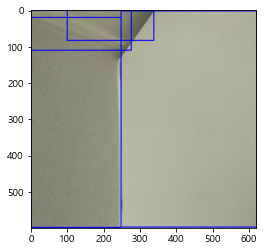

In [95]:
for m in masks :
    x,y,w,h = m['bbox']
    img = cv2.rectangle(img, (x,y), (x+w, y+h), (0,0,255), thickness=2)
plt.imshow(img)

## Custom Augmentations Albumentation 코드

In [4]:
from albumentations.core.transforms_interface import ImageOnlyTransform

class MixedEdgeImage(ImageOnlyTransform):
    def __init__(
        self,
        alpha=0.3,
        beta=0.7,
        always_apply=False,
        p=1
    ):
        super(MixedEdgeImage, self).__init__(always_apply, p)
        self.alpha = alpha
        self.beta = beta
        
    def apply(self, img, **params):
        return self.mixed_edge_image(img)
    
    def mixed_edge_image(self, img) :
        canny_img = cv2.Canny(img, 100, 200, apertureSize=7)
        empty_img = np.zeros((canny_img.shape[0], canny_img.shape[1], 3))
        for i in range(3):
            empty_img[:,:,i] = canny_img
        return empty_img *self.alpha + img * self.beta

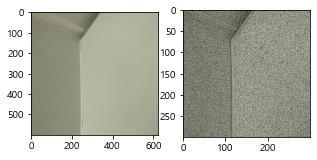

In [5]:
transforms = A.Compose([
    A.Resize(300, 300),
    MixedEdgeImage(alpha=0.3, beta=0.7, p=1),
])

path = "./test.png"

img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)

t_img = transforms(image=img)["image"]

f, axs = plt.subplots(1, 2, figsize=(5, 10))
axs = axs.flatten()

axs[0].imshow(img)
axs[1].imshow(t_img/255)

## CAM 시각화

In [6]:
cfg = {
        "mode" : "train", #train, #infer
        
        "model_name" : "tf_efficientnetv2_s.in21k", #"tf_efficientnetv2_m.in21k", #"swinv2_base_window12to16_192to256_22kft1k",
        #"tf_efficientnetv2_s.in21k",#"eva_large_patch14_196.in22k_ft_in1k",#"beit_base_patch16_224.in22k_ft_in22k",
        "num_classes" : 19,
        
        "learning_rate" : 1e-4,
        "focal_alpha" : 2,
        "focal_gamma" : 2,
        "resize" : 300,
        
        "data_path" : "./data/train",#"./data/train",#"./data/test",
        "epochs" : 60,
        "batch_size" : 16,
        "num_worker" : 6,
        "early_stop_patient" : 10,
                
        "reuse" : False, #True, #False
        "weight_path" : "./ckpt/tf_efficientnetv2_s.in21k/resize300_mixup_CEloss_MixEdge/59E-val0.8441533215273077-tf_efficientnetv2_s.in21k.pth",
        
        "save_path" : "./ckpt/tf_efficientnetv2_s.in21k/resize300_mixup_WeightedCEloss",
        "output_path" : "./output/tf_efficientnetv2_s.in21k/resize300_mixup_WeightedCEloss",
        
        "device" : "cuda",
        "label_name" : ["가구수정", "걸레받이수정", "곰팡이", "꼬임", "녹오염", "들뜸",
                        "면불량", "몰딩수정", "반점", "석고수정", "오염", "오타공", "울음",
                        "이음부불량", "창틀,문틀수정", "터짐", "틈새과다", "피스", "훼손",]
    } 
import torch
import torch.nn as nn
from models import BaseModel
from utils import get_CAM

model = BaseModel(**cfg).to(cfg["device"])
checkpoint = torch.load(cfg["weight_path"])
model.load_state_dict(checkpoint['model_state_dict'])    
model.eval()    

BaseModel(
  (model): EfficientNet(
    (conv_stem): Conv2dSame(3, 24, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn1): BatchNormAct2d(
      24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True
      (drop): Identity()
      (act): SiLU(inplace=True)
    )
    (blocks): Sequential(
      (0): Sequential(
        (0): ConvBnAct(
          (conv): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNormAct2d(
            24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
            (act): SiLU(inplace=True)
          )
          (drop_path): Identity()
        )
        (1): ConvBnAct(
          (conv): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNormAct2d(
            24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
            (act): SiLU(inplace=True)
          )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

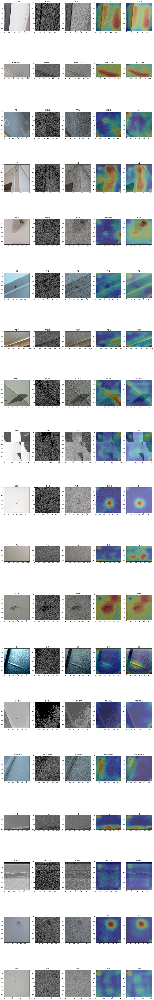

In [7]:
path = './data/train/*'
folder_list = glob(path)
f, axs = plt.subplots(len(folder_list), 5, figsize=(20, 140))
# axs = axs.flatten()
num_sample = 1
smapling_img_list = []
for idx, f in enumerate(folder_list) :
    # img_list = [p for p in glob(os.path.join(f, '*')) if "_aug_" not in p]
    img_list = glob(os.path.join(f, '*'))
    sampling = np.random.choice(len(img_list), num_sample, replace=False)
    smapling_img_list.extend(np.array(img_list)[sampling].tolist())

for idx ,p in enumerate(smapling_img_list) :
    img_array = np.fromfile(p, np.uint8)
    _ori_img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
    ori_img = cv2.cvtColor(_ori_img, cv2.COLOR_BGRA2RGB)
    
    # canny_img = cv2.Canny(_ori_img, 100, 200, apertureSize=5)
    canny_img = cv2.Canny(_ori_img, 100, 200, apertureSize=7)
    _canny_img = np.zeros((canny_img.shape[0], canny_img.shape[1], 3))
    for i in range(3):
        _canny_img[:,:,i] = canny_img
    edge_img = _canny_img *0.5 + ori_img * 0.5
    
    edge_cam_img, edge_pred_cls = get_CAM(model.model, "conv_head", edge_img, cfg["label_name"])
    cam_img, pred_cls = get_CAM(model.model, "conv_head", _ori_img, cfg["label_name"])

    axs[idx][0].imshow(ori_img)
    axs[idx][0].set_title(p.split('\\')[-2])
    
    axs[idx][1].imshow(_canny_img*0.3)
    axs[idx][1].set_title(p.split('\\')[-2])
    
    axs[idx][2].imshow(edge_img/255)
    axs[idx][2].set_title(p.split('\\')[-2])
    
    axs[idx][3].imshow(edge_cam_img/255)
    axs[idx][3].set_title(edge_pred_cls)
    
    axs[idx][4].imshow(cam_img/255)
    axs[idx][4].set_title(pred_cls)
    # break


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

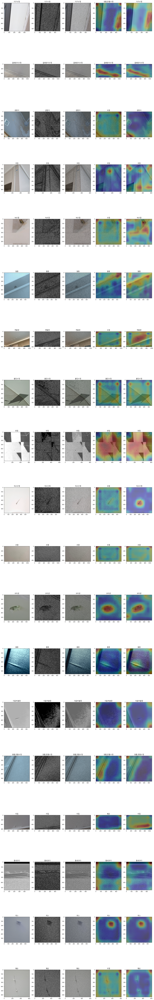

In [11]:
path = './data/train/*'
folder_list = glob(path)
f, axs = plt.subplots(len(folder_list), 5, figsize=(20, 140))
# axs = axs.flatten()
num_sample = 1
smapling_img_list = []
for idx, f in enumerate(folder_list) :
    # img_list = [p for p in glob(os.path.join(f, '*')) if "_aug_" not in p]
    img_list = glob(os.path.join(f, '*'))
    sampling = np.random.choice(len(img_list), num_sample, replace=False)
    smapling_img_list.extend(np.array(img_list)[sampling].tolist())

for idx ,p in enumerate(smapling_img_list) :
    img_array = np.fromfile(p, np.uint8)
    _ori_img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
    ori_img = cv2.cvtColor(_ori_img, cv2.COLOR_BGRA2RGB)
    
    # canny_img = cv2.Canny(_ori_img, 100, 200, apertureSize=5)
    canny_img = cv2.Canny(_ori_img, 100, 200, apertureSize=7)
    _canny_img = np.zeros((canny_img.shape[0], canny_img.shape[1], 3))
    for i in range(3):
        _canny_img[:,:,i] = canny_img
    edge_img = _canny_img *0.4 + ori_img * 0.6
    
    edge_cam_img, edge_pred_cls = get_CAM(model.model, "conv_head", edge_img, cfg["label_name"])
    cam_img, pred_cls = get_CAM(model.model, "conv_head", _ori_img, cfg["label_name"])

    axs[idx][0].imshow(ori_img)
    axs[idx][0].set_title(p.split('\\')[-2])
    
    axs[idx][1].imshow(_canny_img*0.3)
    axs[idx][1].set_title(p.split('\\')[-2])
    
    axs[idx][2].imshow(edge_img/255)
    axs[idx][2].set_title(p.split('\\')[-2])
    
    axs[idx][3].imshow(edge_cam_img/255)
    axs[idx][3].set_title(edge_pred_cls)
    
    axs[idx][4].imshow(cam_img/255)
    axs[idx][4].set_title(pred_cls)
    # break


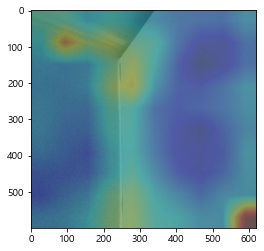

In [8]:
from utils import get_CAM
# import cv2
img = cv2.imread("./test.png")
# img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)

cam_img, pred_cls = get_CAM(model.model, "conv_head", img, cfg["label_name"])

plt.imshow(cam_img/255)
# cv2.imwrite("./cam.jpg", res)

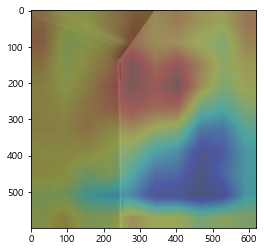

In [10]:
from utils import get_CAM
img = cv2.imread("./test.png")
# img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGB)

cam_img, pred_cls = get_CAM(model.model, "conv_head", img, cfg["label_name"])

plt.imshow(cam_img/255)
# cv2.imwrite("./cam.jpg", res)

## Augmentation 시각화 test

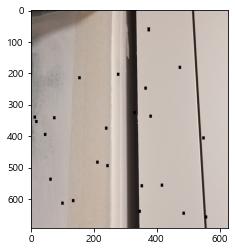

In [20]:
t = A.Compose([
    # A.GridDistortion(always_apply=True)
    # A.OpticalDistortion(p=1, border_mode=3,
    #                     distort_limit=0.3, shift_limit=0.3),   
    # A.GridDistortion(p=1, 
    #                     always_apply=False, 
    #                     num_steps=1, 
    #                     distort_limit=(0, 0.4), 
    #                     interpolation=2, 
    #                     border_mode=3, 
    #                     value=(0, 0, 0), 
    #                     mask_value=None),
    # A.ElasticTransform(p=1, 
    #                 alpha=150, sigma=150 * 0.1, alpha_affine=150 * 0.1),
    # A.Perspective(scale=(0.05, 0.1), keep_size=True, p=1)
    # A.Equalize(by_channels=False,p=1),        
    # A.Spatter(intensity=0.2, p=1)
    # A.Emboss(p=1),
    # A.Sharpen(p=1), A.FancyPCA(p=1)
    # A.Affine(p=1, fit_output=True, mask_interpolation=1, mode=1)
    # A.Affine(p=1, rotate=(-45, 45), fit_output=True, mask_interpolation=1, mode=1)
    # A.GlassBlur(sigma=0.5, max_delta=2,p=1)
    # A.Blur(5, p=1)
    # A.RandomBrightnessContrast(brightness_limit=(-0.4, 0.4), brightness_by_max=False,p=1),
    # A.Posterize(num_bits=4, p=1)
    # A.RandomSunFlare(src_radius=50, p=1)
    # A.RandomSnow(p=1)
    # A.FancyPCA(p=1),
    # A.Cutout(num_holes=12, p=1)
    # A.Downscale(scale_min=0.1, scale_max=0.3, p=1)
    # A.RandomSnow(p=1)
    # A.RandomRain(slant_lower=-10, slant_upper=10,  brightness_coefficient=1,
    #              drop_color=(50, 50, 50), p=1)
    # A.RandomToneCurve(scale=0.2, p=1)
    # A.RingingOvershoot(blur_limit=(1, 3), p=1)
    # A.Solarize(threshold=220,p=1)
    # A.Superpixels(p=1)
    A.CoarseDropout(min_holes=24, max_holes=24, max_height=10, min_height=10 ,p=1),
])

img = cv2.imread("./images/test1.png")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

img = t(image=img)["image"]
plt.imshow(img)

## Confusion Matrix 시각화

In [9]:
import pandas as pd
import os 
from tqdm import tqdm
from glob import glob

df = pd.read_csv("./output/tf_efficientnetv2_s.in21k/sigmoid_labeling_scratch_asyloss_step5_retry_br1/train_dataset_error_rate.csv")
# df = pd.read_csv("./output/tf_efficientnetv2_m.in21k/sigmoid_labeling_scratch_asyloss_step1/train_dataset_error_rate.csv")
# df = pd.read_csv("./output/swinv2_base_window12to16_192to256_22kft1k/more_first_aug/train_dataset_error_rate.csv")
df

,id,label
0,./data/noaug_ori_train\가구수정\0.png,가구수정
1,./data/noaug_ori_train\가구수정\1.png,가구수정
2,./data/noaug_ori_train\가구수정\10.png,가구수정
3,./data/noaug_ori_train\가구수정\11.png,가구수정
4,./data/noaug_ori_train\가구수정\2.png,가구수정
...,...,...
3452,./data/noaug_ori_train\훼손\995.png,훼손
3453,./data/noaug_ori_train\훼손\996.png,훼손
3454,./data/noaug_ori_train\훼손\997.png,훼손
3455,./data/noaug_ori_train\훼손\998.png,훼손


In [6]:
# gt_list  = [i for i in df['id'].iloc if "훼손" not in i]
# gt_list  = [df[df['id'] == i]['label'].values[0] for i in df['id'].iloc if "훼손" not in i]
# # pred_list = list(df[df['label'] != "훼손"]['label'].iloc)

# gt_list

              precision    recall  f1-score   support

        가구수정       1.00      1.00      1.00        12
      걸레받이수정       1.00      1.00      1.00       307
         곰팡이       0.97      0.99      0.98       145
          꼬임       1.00      1.00      1.00       210
         녹오염       1.00      1.00      1.00        14
          들뜸       0.96      1.00      0.98        54
         면불량       0.97      0.88      0.92        99
        몰딩수정       1.00      0.95      0.98       130
          반점       1.00      1.00      1.00         3
        석고수정       0.93      0.89      0.91        57
          오염       0.96      0.95      0.95       595
         오타공       0.96      0.96      0.96       142
          울음       0.87      0.91      0.89        22
       이음부불량       0.94      1.00      0.97        17
     창틀,문틀수정       0.96      0.96      0.96        27
          터짐       0.99      0.96      0.97       162
        틈새과다       1.00      1.00      1.00         5
          피스       0.98    

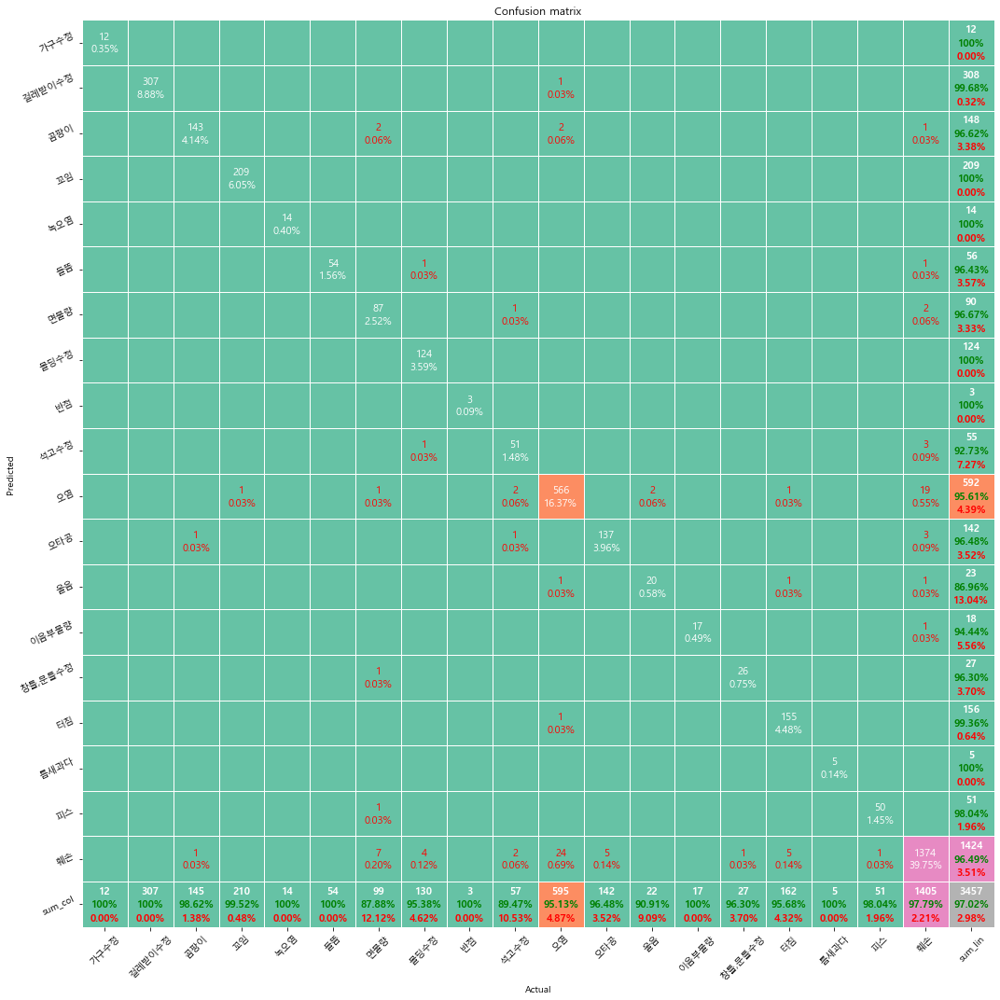

In [10]:
from sklearn.metrics import classification_report, confusion_matrix
from pretty_confusion_matrix.pretty_confusion_matrix import pp_matrix

label_list = ["가구수정", "걸레받이수정", "곰팡이", "꼬임", "녹오염", "들뜸",
"면불량", "몰딩수정", "반점", "석고수정", "오염", "오타공", "울음",
"이음부불량", "창틀,문틀수정", "터짐", "틈새과다", "피스", "훼손",]
# label_list = ["가구수정", "걸레받이수정", "곰팡이", "꼬임", "녹오염", "들뜸",
# "면불량", "몰딩수정", "반점", "석고수정", "오염", "오타공", "울음",
# "이음부불량", "창틀,문틀수정", "터짐", "틈새과다", "피스"]

gt_list = [i.split("\\")[-2] for i in df['id'].iloc]
# gt_list  = [i.split("\\")[-2] for i in df['id'].iloc if "훼손" not in i]
pred_list = list(df['label'].iloc)
# pred_list = [df[df['id'] == i]['label'].values[0] for i in df['id'].iloc if "훼손" not in i]

cm = confusion_matrix(gt_list, pred_list)
# print(cm)
print(classification_report(gt_list, pred_list))
data = pd.DataFrame(cm, index=label_list, columns=label_list)


pp_matrix(data, figsize=[15,15],cmap = 'Set2')

## Zero-Shot classification

In [17]:
from transformers import pipeline
# More models in the model hub.
model_name = "openai/clip-vit-large-patch14-336"
classifier = pipeline("zero-shot-image-classification", model = model_name, device=0)


In [18]:
from glob import glob
from tqdm import tqdm

answer = []
lable_list = ['it is a small spot on wallpaper', 
              'Too much gap between wallpaper and object', 
              'modified wallpaper next to furniture', 
              'There is a rust on wallpaper', 
              'There is an incorrect connection between two wallpaper', 
              'There is a weeping wallpapepr', 
              'modified wallpaper next to window frame', 
              'There is  a bolt', 
              'There is lifted wallpaper', 
              'There is modified gypsum', 
              'There is a error wallpaper',
              'modified wallpaper next to molding', 
              'No need this whole', 
              'There is mold on the wallpaper', 
              'wallpaper that is next to plug is burst', 
              'wallpaper is twist', 
              'wallpaper that is next to skirting need to modify', 
              'polluted wallpaper', 
              'damageed wallpaper']
img_list = glob("./data/noaug_ori_train/*/*")
for p in tqdm(img_list):
    scores = classifier(p, candidate_labels = lable_list)
    print(p.split("\\")[-2])
    print(scores)
    answer.append({
        p : scores
    })
    

import json

with open("./zero_shot_classification.json", "w") as json_file:
    json.dump(answer, json_file, indent=3)


  0%|          | 1/3457 [00:04<4:02:48,  4.22s/it]

가구수정
[{'score': 0.28567734360694885, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.2829394042491913, 'label': 'modified wallpaper next to molding'}, {'score': 0.09494218230247498, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.08017686754465103, 'label': 'modified wallpaper next to window frame'}, {'score': 0.07463903725147247, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.05581618472933769, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.027855483815073967, 'label': 'damageed wallpaper'}, {'score': 0.026195021346211433, 'label': 'it is a small spot on wallpaper'}, {'score': 0.022821787744760513, 'label': 'wallpaper is twist'}, {'score': 0.01681707799434662, 'label': 'There is mold on the wallpaper'}, {'score': 0.015316622331738472, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0048218234442174435, 'label': 'There is modified gypsum'}, {'score': 0.004687925335019827, 'lab

  0%|          | 2/3457 [00:05<2:31:24,  2.63s/it]

가구수정
[{'score': 0.7098008394241333, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.22759713232517242, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.013010947965085506, 'label': 'modified wallpaper next to furniture'}, {'score': 0.007712673861533403, 'label': 'modified wallpaper next to molding'}, {'score': 0.007513574790209532, 'label': 'There is  a bolt'}, {'score': 0.0071118236519396305, 'label': 'it is a small spot on wallpaper'}, {'score': 0.005584775470197201, 'label': 'wallpaper is twist'}, {'score': 0.005349172744899988, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.0035726067144423723, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0029012919403612614, 'label': 'damageed wallpaper'}, {'score': 0.0021535991691052914, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0021290124859660864, 'label': 'There is lifted wallpaper'}, {'score': 0.001901418436318636, 'label':

  0%|          | 3/3457 [00:07<2:03:58,  2.15s/it]

가구수정
[{'score': 0.19830277562141418, 'label': 'modified wallpaper next to molding'}, {'score': 0.17572909593582153, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.15674449503421783, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.15270520746707916, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.11811739951372147, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.10152123868465424, 'label': 'it is a small spot on wallpaper'}, {'score': 0.04693065583705902, 'label': 'modified wallpaper next to window frame'}, {'score': 0.020586734637618065, 'label': 'modified wallpaper next to furniture'}, {'score': 0.012274227105081081, 'label': 'There is mold on the wallpaper'}, {'score': 0.006312726065516472, 'label': 'damageed wallpaper'}, {'score': 0.003260563826188445, 'label': 'wallpaper is twist'}, {'score': 0.0021685182582587004, 'label': 'There is  a bolt'}, {'score': 0.0014596947003155947, 'label': '

  0%|          | 4/3457 [00:08<1:50:20,  1.92s/it]

가구수정
[{'score': 0.6695714592933655, 'label': 'modified wallpaper next to molding'}, {'score': 0.1298714429140091, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.09136464446783066, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.027946237474679947, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02543010376393795, 'label': 'There is mold on the wallpaper'}, {'score': 0.016722986474633217, 'label': 'damageed wallpaper'}, {'score': 0.016355739906430244, 'label': 'modified wallpaper next to window frame'}, {'score': 0.004654056392610073, 'label': 'it is a small spot on wallpaper'}, {'score': 0.004047835245728493, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0031730521004647017, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0030253231525421143, 'label': 'polluted wallpaper'}, {'score': 0.0027001502458006144, 'label': 'wallpaper is twist'}, {'score': 0.0021916504483669996, 'labe

  0%|          | 5/3457 [00:10<1:42:57,  1.79s/it]

가구수정
[{'score': 0.3787514269351959, 'label': 'modified wallpaper next to molding'}, {'score': 0.24491512775421143, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.07777061313390732, 'label': 'modified wallpaper next to window frame'}, {'score': 0.07614357024431229, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.06745714694261551, 'label': 'it is a small spot on wallpaper'}, {'score': 0.05046374350786209, 'label': 'There is  a bolt'}, {'score': 0.034043703228235245, 'label': 'There is lifted wallpaper'}, {'score': 0.022105051204562187, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.012888746336102486, 'label': 'modified wallpaper next to furniture'}, {'score': 0.010930110700428486, 'label': 'There is modified gypsum'}, {'score': 0.007318350952118635, 'label': 'wallpaper is twist'}, {'score': 0.0045518227852880955, 'label': 'damageed wallpaper'}, {'score': 0.0039757550694048405, 'label': 'There is mold on the

  0%|          | 6/3457 [00:12<1:38:36,  1.71s/it]

가구수정
[{'score': 0.34363487362861633, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.24929757416248322, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.16260018944740295, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.08272790908813477, 'label': 'modified wallpaper next to molding'}, {'score': 0.053280774503946304, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.03468871861696243, 'label': 'it is a small spot on wallpaper'}, {'score': 0.016295405104756355, 'label': 'wallpaper is twist'}, {'score': 0.013251861557364464, 'label': 'modified wallpaper next to furniture'}, {'score': 0.012927264906466007, 'label': 'modified wallpaper next to window frame'}, {'score': 0.00869336910545826, 'label': 'There is  a bolt'}, {'score': 0.008289924822747707, 'label': 'damageed wallpaper'}, {'score': 0.00643380219116807, 'label': 'There is mold on the wallpaper'}, {'score': 0.002147954422980547, 'label': 'Th

  0%|          | 7/3457 [00:13<1:35:23,  1.66s/it]

가구수정
[{'score': 0.3433516025543213, 'label': 'modified wallpaper next to window frame'}, {'score': 0.34325143694877625, 'label': 'modified wallpaper next to molding'}, {'score': 0.11530379951000214, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.04777621105313301, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.03528674691915512, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0319330208003521, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.021041641011834145, 'label': 'There is mold on the wallpaper'}, {'score': 0.018982907757163048, 'label': 'modified wallpaper next to furniture'}, {'score': 0.01689051277935505, 'label': 'polluted wallpaper'}, {'score': 0.005751488264650106, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0051500871777534485, 'label': 'wallpaper is twist'}, {'score': 0.004893202800303698, 'label': 'There is lifted wallpaper'}, {'score': 0.004125365521758795, 'lab

  0%|          | 8/3457 [00:15<1:33:08,  1.62s/it]

가구수정
[{'score': 0.3353867828845978, 'label': 'modified wallpaper next to molding'}, {'score': 0.33532536029815674, 'label': 'modified wallpaper next to window frame'}, {'score': 0.09161342680454254, 'label': 'There is mold on the wallpaper'}, {'score': 0.09052744507789612, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.05728518217802048, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.025327853858470917, 'label': 'polluted wallpaper'}, {'score': 0.02185230515897274, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.013680066913366318, 'label': 'damageed wallpaper'}, {'score': 0.009282934479415417, 'label': 'modified wallpaper next to furniture'}, {'score': 0.007744873408228159, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0043649873696267605, 'label': 'wallpaper is twist'}, {'score': 0.003386151045560837, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0019758138805627823, 'label':

  0%|          | 9/3457 [00:16<1:32:09,  1.60s/it]

가구수정
[{'score': 0.279216468334198, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.23997260630130768, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.19844138622283936, 'label': 'modified wallpaper next to molding'}, {'score': 0.08026493340730667, 'label': 'it is a small spot on wallpaper'}, {'score': 0.06686333566904068, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.03650617599487305, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.027664951980113983, 'label': 'There is mold on the wallpaper'}, {'score': 0.021464232355356216, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01067531481385231, 'label': 'There is modified gypsum'}, {'score': 0.00822763703763485, 'label': 'modified wallpaper next to furniture'}, {'score': 0.008152700960636139, 'label': 'wallpaper is twist'}, {'score': 0.006105659995228052, 'label': 'polluted wallpaper'}, {'score': 0.005552072077989578, 'label'

  0%|          | 10/3457 [00:18<1:31:38,  1.60s/it]

가구수정
[{'score': 0.5611263513565063, 'label': 'modified wallpaper next to molding'}, {'score': 0.254917711019516, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.05224935710430145, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.05173054337501526, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02439340204000473, 'label': 'modified wallpaper next to window frame'}, {'score': 0.021607356145977974, 'label': 'it is a small spot on wallpaper'}, {'score': 0.014797095209360123, 'label': 'There is mold on the wallpaper'}, {'score': 0.006837224587798119, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0028354795649647713, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0024533835239708424, 'label': 'damageed wallpaper'}, {'score': 0.0022670060861855745, 'label': 'polluted wallpaper'}, {'score': 0.0021586173679679632, 'label': 'wallpaper is twist'}, {'score': 0.001295325462706387, 'label'

c:\Users\quhb2\Anaconda3\envs\torch-1.11\lib\site-packages\transformers\pipelines\base.py:1036: UserWarning: You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  warnings.warn(
  0%|          | 11/3457 [00:19<1:30:21,  1.57s/it]

가구수정
[{'score': 0.3955305814743042, 'label': 'modified wallpaper next to molding'}, {'score': 0.15663863718509674, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.13573303818702698, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.11246784776449203, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.08299537003040314, 'label': 'modified wallpaper next to window frame'}, {'score': 0.03850466385483742, 'label': 'There is mold on the wallpaper'}, {'score': 0.02977788634598255, 'label': 'modified wallpaper next to furniture'}, {'score': 0.02533988282084465, 'label': 'it is a small spot on wallpaper'}, {'score': 0.00690914411097765, 'label': 'wallpaper is twist'}, {'score': 0.002966613508760929, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0022798804566264153, 'label': 'There is modified gypsum'}, {'score': 0.002180378884077072, 'label': 'polluted wallpaper'}, {'score': 0.002136245835572481, 'label

  0%|          | 12/3457 [00:21<1:30:28,  1.58s/it]

가구수정
[{'score': 0.38939034938812256, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.1529940813779831, 'label': 'modified wallpaper next to molding'}, {'score': 0.0891839936375618, 'label': 'There is mold on the wallpaper'}, {'score': 0.08077366650104523, 'label': 'it is a small spot on wallpaper'}, {'score': 0.05181063339114189, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.04935749992728233, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0400347039103508, 'label': 'modified wallpaper next to window frame'}, {'score': 0.038114920258522034, 'label': 'modified wallpaper next to furniture'}, {'score': 0.033904314041137695, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.03107208013534546, 'label': 'damageed wallpaper'}, {'score': 0.014522582292556763, 'label': 'polluted wallpaper'}, {'score': 0.009881218895316124, 'label': 'wallpaper is twist'}, {'score': 0.008675999008119106, 'label': 'Ther

  0%|          | 13/3457 [00:22<1:31:15,  1.59s/it]

걸레받이수정
[{'score': 0.778509795665741, 'label': 'modified wallpaper next to molding'}, {'score': 0.13229838013648987, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0328836552798748, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.02406829409301281, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.006505616474896669, 'label': 'it is a small spot on wallpaper'}, {'score': 0.004807070828974247, 'label': 'There is modified gypsum'}, {'score': 0.00439597200602293, 'label': 'There is mold on the wallpaper'}, {'score': 0.004058179445564747, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.002380026737228036, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0020198447164148092, 'label': 'There is  a bolt'}, {'score': 0.001955528510734439, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0016315198736265302, 'label': 'wallpaper is twist'}, {'score': 0.0013696413952857256, 'l

  0%|          | 14/3457 [00:24<1:30:20,  1.57s/it]

걸레받이수정
[{'score': 0.5151067972183228, 'label': 'modified wallpaper next to molding'}, {'score': 0.23856112360954285, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0847335159778595, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.04709586501121521, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.040089841932058334, 'label': 'There is mold on the wallpaper'}, {'score': 0.03676823154091835, 'label': 'There is modified gypsum'}, {'score': 0.007891237735748291, 'label': 'There is lifted wallpaper'}, {'score': 0.006962544750422239, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.00565446587279439, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.005015927832573652, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0041787042282521725, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0028998032212257385, 'label': 'damageed wallpaper'}, {'score': 0.00245773792266

  0%|          | 15/3457 [00:26<1:31:07,  1.59s/it]

걸레받이수정
[{'score': 0.28900647163391113, 'label': 'modified wallpaper next to molding'}, {'score': 0.20976980030536652, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.13442279398441315, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.1324213296175003, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.08158894628286362, 'label': 'modified wallpaper next to window frame'}, {'score': 0.07477889209985733, 'label': 'it is a small spot on wallpaper'}, {'score': 0.04462016373872757, 'label': 'modified wallpaper next to furniture'}, {'score': 0.010833087377250195, 'label': 'polluted wallpaper'}, {'score': 0.009486854076385498, 'label': 'wallpaper is twist'}, {'score': 0.0045026917941868305, 'label': 'There is mold on the wallpaper'}, {'score': 0.003433598205447197, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.002428741892799735, 'label': 'damageed wallpaper'}, {'score': 0.0012609860859811306, 'label'

  0%|          | 16/3457 [00:27<1:30:57,  1.59s/it]

걸레받이수정
[{'score': 0.5235868096351624, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.24323470890522003, 'label': 'modified wallpaper next to molding'}, {'score': 0.08341076225042343, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.039988718926906586, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.037119634449481964, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.017686903476715088, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01489162165671587, 'label': 'it is a small spot on wallpaper'}, {'score': 0.011648062616586685, 'label': 'modified wallpaper next to furniture'}, {'score': 0.010624855756759644, 'label': 'There is mold on the wallpaper'}, {'score': 0.009269055910408497, 'label': 'damageed wallpaper'}, {'score': 0.002929751295596361, 'label': 'polluted wallpaper'}, {'score': 0.002359601203352213, 'label': 'wallpaper is twist'}, {'score': 0.0014469280140474439, 'labe

  0%|          | 17/3457 [00:29<1:30:08,  1.57s/it]

걸레받이수정
[{'score': 0.3347890377044678, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.21019767224788666, 'label': 'modified wallpaper next to molding'}, {'score': 0.1661611646413803, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.1164751797914505, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.08407814800739288, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.030941301956772804, 'label': 'it is a small spot on wallpaper'}, {'score': 0.020844845101237297, 'label': 'modified wallpaper next to window frame'}, {'score': 0.014158423990011215, 'label': 'modified wallpaper next to furniture'}, {'score': 0.007976480759680271, 'label': 'damageed wallpaper'}, {'score': 0.005874458700418472, 'label': 'wallpaper is twist'}, {'score': 0.0033504420425742865, 'label': 'There is modified gypsum'}, {'score': 0.0026931986212730408, 'label': 'There is mold on the wallpaper'}, {'score': 0.0013461774215102196, 

  1%|          | 18/3457 [00:30<1:29:30,  1.56s/it]

걸레받이수정
[{'score': 0.5611153841018677, 'label': 'modified wallpaper next to molding'}, {'score': 0.10805199295282364, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.10261952877044678, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.10222355276346207, 'label': 'modified wallpaper next to window frame'}, {'score': 0.04774435982108116, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03358703479170799, 'label': 'modified wallpaper next to furniture'}, {'score': 0.01894349604845047, 'label': 'it is a small spot on wallpaper'}, {'score': 0.006558557972311974, 'label': 'polluted wallpaper'}, {'score': 0.004927466157823801, 'label': 'There is lifted wallpaper'}, {'score': 0.004339682403951883, 'label': 'damageed wallpaper'}, {'score': 0.0032246029004454613, 'label': 'There is mold on the wallpaper'}, {'score': 0.0022361832670867443, 'label': 'There is modified gypsum'}, {'score': 0.0017313634743914008, 'label': 'wall

  1%|          | 19/3457 [00:32<1:29:23,  1.56s/it]

걸레받이수정
[{'score': 0.6985495090484619, 'label': 'modified wallpaper next to molding'}, {'score': 0.19594135880470276, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.03290875628590584, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01919858157634735, 'label': 'There is mold on the wallpaper'}, {'score': 0.01673160493373871, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.016721459105610847, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.007573222275823355, 'label': 'modified wallpaper next to furniture'}, {'score': 0.004130917601287365, 'label': 'it is a small spot on wallpaper'}, {'score': 0.001879114774055779, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0018726601265370846, 'label': 'damageed wallpaper'}, {'score': 0.0015169110847637057, 'label': 'There is a rust on wallpaper'}, {'score': 0.0008376555633731186, 'label': 'There is  a bolt'}, {'score': 0.0005899558891542

  1%|          | 20/3457 [00:33<1:30:02,  1.57s/it]

걸레받이수정
[{'score': 0.44192108511924744, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.3701951205730438, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.08025708049535751, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.043193165212869644, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.026102514937520027, 'label': 'it is a small spot on wallpaper'}, {'score': 0.019252369180321693, 'label': 'modified wallpaper next to molding'}, {'score': 0.004848163574934006, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0035554119385778904, 'label': 'There is  a bolt'}, {'score': 0.002730743493884802, 'label': 'damageed wallpaper'}, {'score': 0.0024657228495925665, 'label': 'There is mold on the wallpaper'}, {'score': 0.0014721705811098218, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0011655316920951009, 'label': 'There is modified gypsum'}, {'score': 0.00103585480246692

  1%|          | 21/3457 [00:35<1:29:34,  1.56s/it]

걸레받이수정
[{'score': 0.3074272572994232, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.13526831567287445, 'label': 'it is a small spot on wallpaper'}, {'score': 0.13355782628059387, 'label': 'modified wallpaper next to molding'}, {'score': 0.07669448852539062, 'label': 'modified wallpaper next to window frame'}, {'score': 0.07168715447187424, 'label': 'modified wallpaper next to furniture'}, {'score': 0.05261196196079254, 'label': 'damageed wallpaper'}, {'score': 0.05048547312617302, 'label': 'There is lifted wallpaper'}, {'score': 0.04053172469139099, 'label': 'wallpaper is twist'}, {'score': 0.029222818091511726, 'label': 'polluted wallpaper'}, {'score': 0.025683410465717316, 'label': 'There is mold on the wallpaper'}, {'score': 0.02464260160923004, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.020689617842435837, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.009457557462155819, 'label': 'There is modifi

  1%|          | 22/3457 [00:37<1:29:43,  1.57s/it]

걸레받이수정
[{'score': 0.4987776577472687, 'label': 'modified wallpaper next to molding'}, {'score': 0.16334611177444458, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.12699417769908905, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.05704294890165329, 'label': 'modified wallpaper next to furniture'}, {'score': 0.043647345155477524, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03635336831212044, 'label': 'There is mold on the wallpaper'}, {'score': 0.03608030453324318, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01395553257316351, 'label': 'it is a small spot on wallpaper'}, {'score': 0.006101094186306, 'label': 'damageed wallpaper'}, {'score': 0.004446092527359724, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0035987775772809982, 'label': 'There is modified gypsum'}, {'score': 0.0031926727388054132, 'label': 'polluted wallpaper'}, {'score': 0.0023946610745042562, 'la

  1%|          | 23/3457 [00:38<1:30:05,  1.57s/it]

걸레받이수정
[{'score': 0.42110559344291687, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.2229902446269989, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.15305578708648682, 'label': 'modified wallpaper next to molding'}, {'score': 0.10726979374885559, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02997594326734543, 'label': 'it is a small spot on wallpaper'}, {'score': 0.012746470980346203, 'label': 'There is mold on the wallpaper'}, {'score': 0.012178041972219944, 'label': 'modified wallpaper next to window frame'}, {'score': 0.010361009277403355, 'label': 'modified wallpaper next to furniture'}, {'score': 0.007648024708032608, 'label': 'damageed wallpaper'}, {'score': 0.006277046166360378, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0056622568517923355, 'label': 'polluted wallpaper'}, {'score': 0.00485560717061162, 'label': 'wallpaper is twist'}, {'score': 0.002254817634820938, 'label'

  1%|          | 24/3457 [00:40<1:29:45,  1.57s/it]

걸레받이수정
[{'score': 0.41180315613746643, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.1915939450263977, 'label': 'it is a small spot on wallpaper'}, {'score': 0.13833409547805786, 'label': 'modified wallpaper next to molding'}, {'score': 0.07785813510417938, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03427007794380188, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.033555932343006134, 'label': 'modified wallpaper next to window frame'}, {'score': 0.03018837235867977, 'label': 'wallpaper is twist'}, {'score': 0.02263421006500721, 'label': 'modified wallpaper next to furniture'}, {'score': 0.018898969516158104, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.014591851271688938, 'label': 'polluted wallpaper'}, {'score': 0.009983991272747517, 'label': 'There is mold on the wallpaper'}, {'score': 0.006046363618224859, 'label': 'damageed wallpaper'}, {'score': 0.004928022623062134, 'label': 

  1%|          | 25/3457 [00:41<1:29:55,  1.57s/it]

걸레받이수정
[{'score': 0.5745411515235901, 'label': 'modified wallpaper next to molding'}, {'score': 0.14829951524734497, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.08125802874565125, 'label': 'modified wallpaper next to furniture'}, {'score': 0.06865280121564865, 'label': 'modified wallpaper next to window frame'}, {'score': 0.04867636784911156, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.021168896928429604, 'label': 'it is a small spot on wallpaper'}, {'score': 0.018226398155093193, 'label': 'There is mold on the wallpaper'}, {'score': 0.014696585945785046, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.009042671881616116, 'label': 'There is lifted wallpaper'}, {'score': 0.007212155964225531, 'label': 'wallpaper is twist'}, {'score': 0.003203556640073657, 'label': 'There is modified gypsum'}, {'score': 0.00169485027436167, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.001343401730991

  1%|          | 26/3457 [00:43<1:29:41,  1.57s/it]

걸레받이수정
[{'score': 0.5069913268089294, 'label': 'modified wallpaper next to molding'}, {'score': 0.2371792048215866, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.08215319365262985, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0767006203532219, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.036926865577697754, 'label': 'modified wallpaper next to window frame'}, {'score': 0.026364782825112343, 'label': 'modified wallpaper next to furniture'}, {'score': 0.012819573283195496, 'label': 'it is a small spot on wallpaper'}, {'score': 0.009135840460658073, 'label': 'There is mold on the wallpaper'}, {'score': 0.0031314133666455746, 'label': 'damageed wallpaper'}, {'score': 0.002176385372877121, 'label': 'polluted wallpaper'}, {'score': 0.002148327650502324, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0016791967209428549, 'label': 'wallpaper is twist'}, {'score': 0.001103188726119697, 'label

  1%|          | 27/3457 [00:44<1:29:50,  1.57s/it]

걸레받이수정
[{'score': 0.32290467619895935, 'label': 'modified wallpaper next to molding'}, {'score': 0.19247640669345856, 'label': 'There is mold on the wallpaper'}, {'score': 0.17364400625228882, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.09546318650245667, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.051197461783885956, 'label': 'it is a small spot on wallpaper'}, {'score': 0.038628995418548584, 'label': 'polluted wallpaper'}, {'score': 0.03804099187254906, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.024974361062049866, 'label': 'modified wallpaper next to window frame'}, {'score': 0.021279925480484962, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.017621565610170364, 'label': 'modified wallpaper next to furniture'}, {'score': 0.008067495189607143, 'label': 'damageed wallpaper'}, {'score': 0.005364411976188421, 'label': 'wallpaper is twist'}, {'score': 0.004508808720856905, 'label

  1%|          | 28/3457 [00:46<1:29:36,  1.57s/it]

걸레받이수정
[{'score': 0.42004862427711487, 'label': 'modified wallpaper next to molding'}, {'score': 0.16396746039390564, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.14501602947711945, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.0861692726612091, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.057454343885183334, 'label': 'modified wallpaper next to furniture'}, {'score': 0.038266200572252274, 'label': 'it is a small spot on wallpaper'}, {'score': 0.03105352632701397, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.015420506708323956, 'label': 'modified wallpaper next to window frame'}, {'score': 0.011157444678246975, 'label': 'damageed wallpaper'}, {'score': 0.008453093469142914, 'label': 'There is lifted wallpaper'}, {'score': 0.007519556209445, 'label': 'There is mold on the wallpaper'}, {'score': 0.0059534297324717045, 'label': 'polluted wallpaper'}, {'score': 0.0032227043993771076, '

  1%|          | 29/3457 [00:48<1:30:35,  1.59s/it]

걸레받이수정
[{'score': 0.28028976917266846, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.21855610609054565, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.11442345380783081, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0833367332816124, 'label': 'There is lifted wallpaper'}, {'score': 0.06377923488616943, 'label': 'modified wallpaper next to furniture'}, {'score': 0.05408332496881485, 'label': 'it is a small spot on wallpaper'}, {'score': 0.03774040937423706, 'label': 'modified wallpaper next to molding'}, {'score': 0.035178396850824356, 'label': 'polluted wallpaper'}, {'score': 0.03481972590088844, 'label': 'There is modified gypsum'}, {'score': 0.023826560005545616, 'label': 'wallpaper is twist'}, {'score': 0.012111548334360123, 'label': 'damageed wallpaper'}, {'score': 0.010305027477443218, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.008086888119578362, 'label': 'There is mold on the

  1%|          | 30/3457 [00:49<1:29:59,  1.58s/it]

걸레받이수정
[{'score': 0.7191805243492126, 'label': 'modified wallpaper next to molding'}, {'score': 0.0951315313577652, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.07667147368192673, 'label': 'modified wallpaper next to window frame'}, {'score': 0.04727865383028984, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.023070182651281357, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.012430247850716114, 'label': 'it is a small spot on wallpaper'}, {'score': 0.011237592436373234, 'label': 'There is mold on the wallpaper'}, {'score': 0.0074789859354496, 'label': 'modified wallpaper next to furniture'}, {'score': 0.002326850313693285, 'label': 'wallpaper is twist'}, {'score': 0.0018641114002093673, 'label': 'damageed wallpaper'}, {'score': 0.0013821835163980722, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0006350586772896349, 'label': 'polluted wallpaper'}, {'score': 0.00041585456347092986, 'lab

  1%|          | 31/3457 [00:51<1:29:20,  1.56s/it]

걸레받이수정
[{'score': 0.4512403607368469, 'label': 'modified wallpaper next to molding'}, {'score': 0.2236308455467224, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.06776048988103867, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.05409451574087143, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.04561883956193924, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0423428975045681, 'label': 'There is a rust on wallpaper'}, {'score': 0.03492731228470802, 'label': 'modified wallpaper next to window frame'}, {'score': 0.025973452255129814, 'label': 'it is a small spot on wallpaper'}, {'score': 0.01677829585969448, 'label': 'There is mold on the wallpaper'}, {'score': 0.01032679807394743, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.00863824225962162, 'label': 'There is lifted wallpaper'}, {'score': 0.007990622892975807, 'label': 'wallpaper is twist'}, {'score': 0.00384897016920149

  1%|          | 32/3457 [00:52<1:29:46,  1.57s/it]

걸레받이수정
[{'score': 0.32544246315956116, 'label': 'modified wallpaper next to molding'}, {'score': 0.21189631521701813, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.18484710156917572, 'label': 'modified wallpaper next to window frame'}, {'score': 0.06917542219161987, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0468277744948864, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.046223897486925125, 'label': 'modified wallpaper next to furniture'}, {'score': 0.03661300987005234, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.02391349896788597, 'label': 'it is a small spot on wallpaper'}, {'score': 0.023715956136584282, 'label': 'There is mold on the wallpaper'}, {'score': 0.012363875284790993, 'label': 'There is a rust on wallpaper'}, {'score': 0.0051680379547178745, 'label': 'damageed wallpaper'}, {'score': 0.004331693053245544, 'label': 'polluted wallpaper'}, {'score': 0.004107709042727947

  1%|          | 33/3457 [00:54<1:29:09,  1.56s/it]

걸레받이수정
[{'score': 0.33158108592033386, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.29150182008743286, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.14678390324115753, 'label': 'modified wallpaper next to molding'}, {'score': 0.07515744119882584, 'label': 'modified wallpaper next to window frame'}, {'score': 0.03917768597602844, 'label': 'modified wallpaper next to furniture'}, {'score': 0.036919403821229935, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.029078641906380653, 'label': 'it is a small spot on wallpaper'}, {'score': 0.010994943790137768, 'label': 'There is mold on the wallpaper'}, {'score': 0.010418265126645565, 'label': 'polluted wallpaper'}, {'score': 0.008618678897619247, 'label': 'wallpaper is twist'}, {'score': 0.00687303626909852, 'label': 'There is modified gypsum'}, {'score': 0.006333814933896065, 'label': 'damageed wallpaper'}, {'score': 0.0036625578068196774, 'label': 'wallpaper t

  1%|          | 34/3457 [00:55<1:28:49,  1.56s/it]

걸레받이수정
[{'score': 0.4442360997200012, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.380666583776474, 'label': 'modified wallpaper next to molding'}, {'score': 0.05505118519067764, 'label': 'There is mold on the wallpaper'}, {'score': 0.037150654941797256, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.021643061190843582, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.020169973373413086, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01948976330459118, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0071732900105416775, 'label': 'it is a small spot on wallpaper'}, {'score': 0.004323702305555344, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.004290226846933365, 'label': 'damageed wallpaper'}, {'score': 0.003068093443289399, 'label': 'There is modified gypsum'}, {'score': 0.0014182708691805601, 'label': 'polluted wallpaper'}, {'score': 0.0004222301358822733,

  1%|          | 35/3457 [00:57<1:28:26,  1.55s/it]

걸레받이수정
[{'score': 0.49360305070877075, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.2112397849559784, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.18451599776744843, 'label': 'modified wallpaper next to molding'}, {'score': 0.05357690900564194, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.017361393198370934, 'label': 'it is a small spot on wallpaper'}, {'score': 0.009805941954255104, 'label': 'There is mold on the wallpaper'}, {'score': 0.007146551739424467, 'label': 'modified wallpaper next to window frame'}, {'score': 0.005454665049910545, 'label': 'modified wallpaper next to furniture'}, {'score': 0.005350131541490555, 'label': 'There is modified gypsum'}, {'score': 0.0038956047501415014, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.00272275204770267, 'label': 'damageed wallpaper'}, {'score': 0.001438689068891108, 'label': 'polluted wallpaper'}, {'score': 0.0013628614833578467,

  1%|          | 36/3457 [00:58<1:28:42,  1.56s/it]

걸레받이수정
[{'score': 0.5735838413238525, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.15129563212394714, 'label': 'modified wallpaper next to molding'}, {'score': 0.07143497467041016, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.054779455065727234, 'label': 'it is a small spot on wallpaper'}, {'score': 0.03968757018446922, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.03339409828186035, 'label': 'modified wallpaper next to furniture'}, {'score': 0.021945418789982796, 'label': 'polluted wallpaper'}, {'score': 0.020179197192192078, 'label': 'modified wallpaper next to window frame'}, {'score': 0.009522437117993832, 'label': 'There is modified gypsum'}, {'score': 0.007528099697083235, 'label': 'wallpaper is twist'}, {'score': 0.006946648471057415, 'label': 'There is lifted wallpaper'}, {'score': 0.0027250151615589857, 'label': 'damageed wallpaper'}, {'score': 0.0026061064563691616, 'label': 'wallpaper that 

  1%|          | 37/3457 [01:00<1:28:01,  1.54s/it]

걸레받이수정
[{'score': 0.6738511323928833, 'label': 'modified wallpaper next to molding'}, {'score': 0.15517877042293549, 'label': 'There is mold on the wallpaper'}, {'score': 0.07005923986434937, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.02572188526391983, 'label': 'There is modified gypsum'}, {'score': 0.021881531924009323, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.016240423545241356, 'label': 'modified wallpaper next to window frame'}, {'score': 0.015232681296765804, 'label': 'polluted wallpaper'}, {'score': 0.011692473664879799, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0030020740814507008, 'label': 'damageed wallpaper'}, {'score': 0.0022629660088568926, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0016275269445031881, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0010078595951199532, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0006758568342775

  1%|          | 38/3457 [01:02<1:29:53,  1.58s/it]

걸레받이수정
[{'score': 0.25522980093955994, 'label': 'it is a small spot on wallpaper'}, {'score': 0.17275147140026093, 'label': 'modified wallpaper next to window frame'}, {'score': 0.11137305200099945, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.10124223679304123, 'label': 'modified wallpaper next to molding'}, {'score': 0.07966626435518265, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.07575031369924545, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.06725329905748367, 'label': 'polluted wallpaper'}, {'score': 0.04808090999722481, 'label': 'There is mold on the wallpaper'}, {'score': 0.04462211951613426, 'label': 'modified wallpaper next to furniture'}, {'score': 0.011814712546765804, 'label': 'There is lifted wallpaper'}, {'score': 0.007480067200958729, 'label': 'wallpaper is twist'}, {'score': 0.006762886885553598, 'label': 'damageed wallpaper'}, {'score': 0.0064797839149832726, 'label': 'There is a ru

  1%|          | 39/3457 [01:03<1:29:27,  1.57s/it]

걸레받이수정
[{'score': 0.26984521746635437, 'label': 'it is a small spot on wallpaper'}, {'score': 0.2063485085964203, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.13742156326770782, 'label': 'modified wallpaper next to furniture'}, {'score': 0.10129604488611221, 'label': 'modified wallpaper next to window frame'}, {'score': 0.07126332819461823, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.061972424387931824, 'label': 'modified wallpaper next to molding'}, {'score': 0.04295947775244713, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.024115419015288353, 'label': 'polluted wallpaper'}, {'score': 0.023179898038506508, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.02237388677895069, 'label': 'There is mold on the wallpaper'}, {'score': 0.013059960678219795, 'label': 'wallpaper is twist'}, {'score': 0.009082105942070484, 'label': 'There is a weeping wallpapepr'}, {'score': 0.008644035086035728

  1%|          | 40/3457 [01:05<1:30:15,  1.58s/it]

걸레받이수정
[{'score': 0.4742521345615387, 'label': 'modified wallpaper next to molding'}, {'score': 0.1453624963760376, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.09593719989061356, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.09217377752065659, 'label': 'it is a small spot on wallpaper'}, {'score': 0.06586182117462158, 'label': 'modified wallpaper next to window frame'}, {'score': 0.04621018469333649, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.018689414486289024, 'label': 'There is mold on the wallpaper'}, {'score': 0.015331355854868889, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.014957934617996216, 'label': 'modified wallpaper next to furniture'}, {'score': 0.009414312429726124, 'label': 'There is  a bolt'}, {'score': 0.009193704463541508, 'label': 'damageed wallpaper'}, {'score': 0.004522389732301235, 'label': 'polluted wallpaper'}, {'score': 0.002262501046061516, 'label': 'T

  1%|          | 41/3457 [01:06<1:29:18,  1.57s/it]

걸레받이수정
[{'score': 0.6033052802085876, 'label': 'modified wallpaper next to molding'}, {'score': 0.2366185188293457, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.03657527267932892, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.030261356383562088, 'label': 'modified wallpaper next to window frame'}, {'score': 0.02938423492014408, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.023911230266094208, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.015596267767250538, 'label': 'it is a small spot on wallpaper'}, {'score': 0.009086089208722115, 'label': 'modified wallpaper next to furniture'}, {'score': 0.007227225229144096, 'label': 'There is mold on the wallpaper'}, {'score': 0.004756728652864695, 'label': 'damageed wallpaper'}, {'score': 0.0009724529227241874, 'label': 'wallpaper is twist'}, {'score': 0.0006168883992359042, 'label': 'There is modified gypsum'}, {'score': 0.0004156470822636038

  1%|          | 42/3457 [01:08<1:28:52,  1.56s/it]

걸레받이수정
[{'score': 0.8545075058937073, 'label': 'modified wallpaper next to molding'}, {'score': 0.037799663841724396, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.03396479785442352, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.030964607372879982, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.021087775006890297, 'label': 'modified wallpaper next to furniture'}, {'score': 0.01049985084682703, 'label': 'modified wallpaper next to window frame'}, {'score': 0.003480619518086314, 'label': 'it is a small spot on wallpaper'}, {'score': 0.00280076009221375, 'label': 'damageed wallpaper'}, {'score': 0.0018631622660905123, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.001470759860239923, 'label': 'There is mold on the wallpaper'}, {'score': 0.0006322305998764932, 'label': 'There is modified gypsum'}, {'score': 0.00023127479653339833, 'label': 'wallpaper is twist'}, {'score': 0.0001739992731017

  1%|          | 43/3457 [01:10<1:29:44,  1.58s/it]

걸레받이수정
[{'score': 0.43314123153686523, 'label': 'modified wallpaper next to molding'}, {'score': 0.24877525866031647, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.07408886402845383, 'label': 'modified wallpaper next to window frame'}, {'score': 0.05675998702645302, 'label': 'There is mold on the wallpaper'}, {'score': 0.04734918102622032, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03934679925441742, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.03547554835677147, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.029116064310073853, 'label': 'modified wallpaper next to furniture'}, {'score': 0.01215510442852974, 'label': 'it is a small spot on wallpaper'}, {'score': 0.009356706403195858, 'label': 'There is a rust on wallpaper'}, {'score': 0.00531347468495369, 'label': 'damageed wallpaper'}, {'score': 0.003646367695182562, 'label': 'polluted wallpaper'}, {'score': 0.0022382161114364862,

  1%|▏         | 44/3457 [01:11<1:28:36,  1.56s/it]

걸레받이수정
[{'score': 0.42047515511512756, 'label': 'modified wallpaper next to molding'}, {'score': 0.11444506049156189, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.09818381071090698, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0887262150645256, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.06812678277492523, 'label': 'modified wallpaper next to furniture'}, {'score': 0.048671673983335495, 'label': 'modified wallpaper next to window frame'}, {'score': 0.04729348421096802, 'label': 'There is mold on the wallpaper'}, {'score': 0.03528578579425812, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.020452052354812622, 'label': 'wallpaper is twist'}, {'score': 0.015660898759961128, 'label': 'There is lifted wallpaper'}, {'score': 0.0127415731549263, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.007467090152204037, 'label': 'There is  a bolt'}, {'score': 0.006508255377411842, 'label

  1%|▏         | 45/3457 [01:13<1:29:40,  1.58s/it]

걸레받이수정
[{'score': 0.5282582640647888, 'label': 'modified wallpaper next to molding'}, {'score': 0.16079407930374146, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.13278503715991974, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.06756368279457092, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03792553022503853, 'label': 'There is mold on the wallpaper'}, {'score': 0.018074555322527885, 'label': 'modified wallpaper next to window frame'}, {'score': 0.016146304085850716, 'label': 'it is a small spot on wallpaper'}, {'score': 0.015003236010670662, 'label': 'modified wallpaper next to furniture'}, {'score': 0.00599218113347888, 'label': 'There is modified gypsum'}, {'score': 0.005275337491184473, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.00404749670997262, 'label': 'wallpaper is twist'}, {'score': 0.003731859615072608, 'label': 'damageed wallpaper'}, {'score': 0.001376353669911623, 'la

  1%|▏         | 46/3457 [01:14<1:30:10,  1.59s/it]

걸레받이수정
[{'score': 0.315216600894928, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.28888022899627686, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.2400681972503662, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.05458327755331993, 'label': 'modified wallpaper next to molding'}, {'score': 0.03911038115620613, 'label': 'modified wallpaper next to window frame'}, {'score': 0.016668247058987617, 'label': 'it is a small spot on wallpaper'}, {'score': 0.016210144385695457, 'label': 'modified wallpaper next to furniture'}, {'score': 0.008365270681679249, 'label': 'wallpaper is twist'}, {'score': 0.007881049998104572, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.005462699569761753, 'label': 'damageed wallpaper'}, {'score': 0.0021976951975375414, 'label': 'There is mold on the wallpaper'}, {'score': 0.0014741350896656513, 'label': 'There is lifted wallpaper'}, {'score': 0.0011847516288980842,

  1%|▏         | 47/3457 [01:16<1:30:20,  1.59s/it]

걸레받이수정
[{'score': 0.23856335878372192, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.2320944368839264, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.15961888432502747, 'label': 'modified wallpaper next to molding'}, {'score': 0.14396290481090546, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.10274327546358109, 'label': 'modified wallpaper next to furniture'}, {'score': 0.042325619608163834, 'label': 'it is a small spot on wallpaper'}, {'score': 0.03587130829691887, 'label': 'modified wallpaper next to window frame'}, {'score': 0.010229289531707764, 'label': 'There is mold on the wallpaper'}, {'score': 0.00991810578852892, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.007745590526610613, 'label': 'damageed wallpaper'}, {'score': 0.007600719574838877, 'label': 'wallpaper is twist'}, {'score': 0.0023290617391467094, 'label': 'There is  a bolt'}, {'score': 0.0017259293235838413, 'label': 

  1%|▏         | 48/3457 [01:17<1:29:01,  1.57s/it]

걸레받이수정
[{'score': 0.2933928072452545, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.23338192701339722, 'label': 'modified wallpaper next to molding'}, {'score': 0.20352788269519806, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.08913005888462067, 'label': 'There is mold on the wallpaper'}, {'score': 0.06865886598825455, 'label': 'polluted wallpaper'}, {'score': 0.03993288055062294, 'label': 'it is a small spot on wallpaper'}, {'score': 0.02103131264448166, 'label': 'modified wallpaper next to window frame'}, {'score': 0.016810759902000427, 'label': 'damageed wallpaper'}, {'score': 0.012021603062748909, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.005916673224419355, 'label': 'There is modified gypsum'}, {'score': 0.0054702539928257465, 'label': 'wallpaper is twist'}, {'score': 0.005409638863056898, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.004251041915267706, 'label': 'modified w

  1%|▏         | 49/3457 [01:19<1:28:26,  1.56s/it]

걸레받이수정
[{'score': 0.32458820939064026, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.14882203936576843, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.10548292845487595, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.08704221993684769, 'label': 'it is a small spot on wallpaper'}, {'score': 0.055052973330020905, 'label': 'There is lifted wallpaper'}, {'score': 0.051925741136074066, 'label': 'modified wallpaper next to molding'}, {'score': 0.04692334681749344, 'label': 'There is modified gypsum'}, {'score': 0.046432171016931534, 'label': 'modified wallpaper next to furniture'}, {'score': 0.024538934230804443, 'label': 'damageed wallpaper'}, {'score': 0.02332250215113163, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.022293657064437866, 'label': 'There is mold on the wallpaper'}, {'score': 0.01796814054250717, 'label': 'wallpaper is twist'}, {'score': 0.012088366784155369, 'label': 'There 

  1%|▏         | 50/3457 [01:20<1:27:38,  1.54s/it]

걸레받이수정
[{'score': 0.4562198221683502, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.18542224168777466, 'label': 'modified wallpaper next to molding'}, {'score': 0.1382160633802414, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.1273850053548813, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02560742013156414, 'label': 'it is a small spot on wallpaper'}, {'score': 0.02027542144060135, 'label': 'modified wallpaper next to furniture'}, {'score': 0.014511319808661938, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.006757870316505432, 'label': 'damageed wallpaper'}, {'score': 0.006660844665020704, 'label': 'There is mold on the wallpaper'}, {'score': 0.006297766696661711, 'label': 'modified wallpaper next to window frame'}, {'score': 0.005531289614737034, 'label': 'There is modified gypsum'}, {'score': 0.002286505652591586, 'label': 'polluted wallpaper'}, {'score': 0.001679291483014822, 'lab

  1%|▏         | 51/3457 [01:22<1:28:24,  1.56s/it]

걸레받이수정
[{'score': 0.3044898808002472, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.2935285270214081, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.13909487426280975, 'label': 'modified wallpaper next to molding'}, {'score': 0.08203475922346115, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.07104501873254776, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.02667238749563694, 'label': 'it is a small spot on wallpaper'}, {'score': 0.022717010229825974, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0197334922850132, 'label': 'There is mold on the wallpaper'}, {'score': 0.014849073253571987, 'label': 'polluted wallpaper'}, {'score': 0.012030353769659996, 'label': 'damageed wallpaper'}, {'score': 0.007786796893924475, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0023929765447974205, 'label': 'wallpaper is twist'}, {'score': 0.0014054494677111506, 'label': 

  2%|▏         | 52/3457 [01:24<1:27:35,  1.54s/it]

걸레받이수정
[{'score': 0.609006404876709, 'label': 'modified wallpaper next to molding'}, {'score': 0.14296509325504303, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.1259762942790985, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.048235468566417694, 'label': 'damageed wallpaper'}, {'score': 0.022341055795550346, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.017798596993088722, 'label': 'modified wallpaper next to furniture'}, {'score': 0.016195455566048622, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.005230208393186331, 'label': 'modified wallpaper next to window frame'}, {'score': 0.003843721468001604, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0030440285336226225, 'label': 'There is mold on the wallpaper'}, {'score': 0.0022171582095324993, 'label': 'wallpaper is twist'}, {'score': 0.0015765397110953927, 'label': 'There is lifted wallpaper'}, {'score': 0.00113431585486978

  2%|▏         | 53/3457 [01:25<1:27:55,  1.55s/it]

걸레받이수정
[{'score': 0.4267503321170807, 'label': 'modified wallpaper next to molding'}, {'score': 0.31589633226394653, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.14796164631843567, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.03812885284423828, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.025970986112952232, 'label': 'modified wallpaper next to furniture'}, {'score': 0.013367749750614166, 'label': 'it is a small spot on wallpaper'}, {'score': 0.011699545197188854, 'label': 'modified wallpaper next to window frame'}, {'score': 0.007152948062866926, 'label': 'damageed wallpaper'}, {'score': 0.004045723471790552, 'label': 'There is modified gypsum'}, {'score': 0.003341353964060545, 'label': 'There is mold on the wallpaper'}, {'score': 0.0015352845657616854, 'label': 'wallpaper is twist'}, {'score': 0.0015207445248961449, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.001407508039847016

  2%|▏         | 54/3457 [01:27<1:28:05,  1.55s/it]

걸레받이수정
[{'score': 0.5747231841087341, 'label': 'modified wallpaper next to molding'}, {'score': 0.21122851967811584, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.04143942520022392, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.035798728466033936, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.03244877979159355, 'label': 'modified wallpaper next to furniture'}, {'score': 0.032014086842536926, 'label': 'modified wallpaper next to window frame'}, {'score': 0.02979184314608574, 'label': 'There is mold on the wallpaper'}, {'score': 0.016764001920819283, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.01353471726179123, 'label': 'damageed wallpaper'}, {'score': 0.0054322597570717335, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0028903386555612087, 'label': 'There is a rust on wallpaper'}, {'score': 0.00195335247553885, 'label': 'polluted wallpaper'}, {'score': 0.00075930228922516

  2%|▏         | 55/3457 [01:28<1:27:54,  1.55s/it]

걸레받이수정
[{'score': 0.5896520614624023, 'label': 'modified wallpaper next to molding'}, {'score': 0.18267160654067993, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.09058644622564316, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.061759624630212784, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.022059621289372444, 'label': 'modified wallpaper next to furniture'}, {'score': 0.021860623732209206, 'label': 'it is a small spot on wallpaper'}, {'score': 0.014388982206583023, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0068657477386295795, 'label': 'There is mold on the wallpaper'}, {'score': 0.003616614965721965, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0017907401779666543, 'label': 'wallpaper is twist'}, {'score': 0.0013634591596201062, 'label': 'damageed wallpaper'}, {'score': 0.0011100522242486477, 'label': 'There is  a bolt'}, {'score': 0.0006812470383010805, 'l

  2%|▏         | 56/3457 [01:30<1:27:26,  1.54s/it]

걸레받이수정
[{'score': 0.4184236228466034, 'label': 'modified wallpaper next to molding'}, {'score': 0.3809753954410553, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.05532456934452057, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.05367172881960869, 'label': 'it is a small spot on wallpaper'}, {'score': 0.02034112811088562, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.01806301809847355, 'label': 'There is mold on the wallpaper'}, {'score': 0.01742861419916153, 'label': 'modified wallpaper next to window frame'}, {'score': 0.013369406573474407, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.008204197511076927, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0034430569503456354, 'label': 'damageed wallpaper'}, {'score': 0.0032849677372723818, 'label': 'There is lifted wallpaper'}, {'score': 0.0018194855656474829, 'label': 'wallpaper is twist'}, {'score': 0.0014723826898261905,

  2%|▏         | 57/3457 [01:31<1:27:34,  1.55s/it]

걸레받이수정
[{'score': 0.4783174395561218, 'label': 'modified wallpaper next to molding'}, {'score': 0.20401807129383087, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.1671801209449768, 'label': 'modified wallpaper next to window frame'}, {'score': 0.05023527145385742, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.042313072830438614, 'label': 'There is mold on the wallpaper'}, {'score': 0.014498061500489712, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0127643421292305, 'label': 'There is modified gypsum'}, {'score': 0.008632108569145203, 'label': 'polluted wallpaper'}, {'score': 0.007903234101831913, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0046019298024475574, 'label': 'modified wallpaper next to furniture'}, {'score': 0.003515370190143585, 'label': 'damageed wallpaper'}, {'score': 0.0025590891018509865, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.001106936950236559, '

  2%|▏         | 58/3457 [01:33<1:27:41,  1.55s/it]

걸레받이수정
[{'score': 0.5139743685722351, 'label': 'modified wallpaper next to molding'}, {'score': 0.30412909388542175, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.043492477387189865, 'label': 'modified wallpaper next to furniture'}, {'score': 0.041007768362760544, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.034521665424108505, 'label': 'modified wallpaper next to window frame'}, {'score': 0.02485843002796173, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.0105446707457304, 'label': 'it is a small spot on wallpaper'}, {'score': 0.00999593548476696, 'label': 'There is mold on the wallpaper'}, {'score': 0.005100791342556477, 'label': 'damageed wallpaper'}, {'score': 0.003881654469296336, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.003044990822672844, 'label': 'wallpaper is twist'}, {'score': 0.0018106471979990602, 'label': 'There is lifted wallpaper'}, {'score': 0.001510174130089581, 

  2%|▏         | 59/3457 [01:34<1:27:41,  1.55s/it]

걸레받이수정
[{'score': 0.6830095052719116, 'label': 'modified wallpaper next to molding'}, {'score': 0.20488350093364716, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.024197636172175407, 'label': 'it is a small spot on wallpaper'}, {'score': 0.017720632255077362, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.01581423543393612, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.011677444912493229, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.01115594431757927, 'label': 'damageed wallpaper'}, {'score': 0.008625316433608532, 'label': 'modified wallpaper next to furniture'}, {'score': 0.00670654745772481, 'label': 'modified wallpaper next to window frame'}, {'score': 0.005626535043120384, 'label': 'There is mold on the wallpaper'}, {'score': 0.004308044444769621, 'label': 'polluted wallpaper'}, {'score': 0.0027517525013536215, 'label': 'wallpaper is twist'}, {'score': 0.0022356146946549416, 'labe

  2%|▏         | 60/3457 [01:36<1:27:46,  1.55s/it]

걸레받이수정
[{'score': 0.3025544285774231, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.2871398329734802, 'label': 'modified wallpaper next to molding'}, {'score': 0.18455490469932556, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.044122934341430664, 'label': 'modified wallpaper next to window frame'}, {'score': 0.03979497402906418, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.031219886615872383, 'label': 'it is a small spot on wallpaper'}, {'score': 0.02791048213839531, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.025899676606059074, 'label': 'damageed wallpaper'}, {'score': 0.020620213821530342, 'label': 'modified wallpaper next to furniture'}, {'score': 0.018272504210472107, 'label': 'There is mold on the wallpaper'}, {'score': 0.011659434996545315, 'label': 'wallpaper is twist'}, {'score': 0.0037442485336214304, 'label': 'polluted wallpaper'}, {'score': 0.0008174802642315626, 'label

  2%|▏         | 61/3457 [01:37<1:28:08,  1.56s/it]

걸레받이수정
[{'score': 0.3314881920814514, 'label': 'modified wallpaper next to molding'}, {'score': 0.1664724051952362, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.13229724764823914, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.10531874746084213, 'label': 'modified wallpaper next to window frame'}, {'score': 0.08533479273319244, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.06380221992731094, 'label': 'modified wallpaper next to furniture'}, {'score': 0.06224974989891052, 'label': 'it is a small spot on wallpaper'}, {'score': 0.01574244350194931, 'label': 'wallpaper is twist'}, {'score': 0.014463558793067932, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.011815264821052551, 'label': 'There is mold on the wallpaper'}, {'score': 0.004250328056514263, 'label': 'damageed wallpaper'}, {'score': 0.0037053641863167286, 'label': 'polluted wallpaper'}, {'score': 0.0009122969349846244, 'label': 

  2%|▏         | 62/3457 [01:39<1:28:02,  1.56s/it]

걸레받이수정
[{'score': 0.5886932015419006, 'label': 'modified wallpaper next to molding'}, {'score': 0.23114052414894104, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.05555567890405655, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.03676364943385124, 'label': 'modified wallpaper next to window frame'}, {'score': 0.027699576690793037, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02292620576918125, 'label': 'modified wallpaper next to furniture'}, {'score': 0.014893376268446445, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0055518788285553455, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.003890382358804345, 'label': 'There is mold on the wallpaper'}, {'score': 0.003670624690130353, 'label': 'There is modified gypsum'}, {'score': 0.0036541044246405363, 'label': 'damageed wallpaper'}, {'score': 0.003026742720976472, 'label': 'wallpaper is twist'}, {'score': 0.0010568173602223396

  2%|▏         | 63/3457 [01:41<1:27:38,  1.55s/it]

걸레받이수정
[{'score': 0.5418753027915955, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.15736418962478638, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.12626107037067413, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.09350714087486267, 'label': 'modified wallpaper next to molding'}, {'score': 0.0308871828019619, 'label': 'it is a small spot on wallpaper'}, {'score': 0.01760617084801197, 'label': 'damageed wallpaper'}, {'score': 0.011270205490291119, 'label': 'modified wallpaper next to furniture'}, {'score': 0.006569290533661842, 'label': 'wallpaper is twist'}, {'score': 0.004445097409188747, 'label': 'There is mold on the wallpaper'}, {'score': 0.0028763606678694487, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0024411214981228113, 'label': 'polluted wallpaper'}, {'score': 0.0023650641087442636, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0012969719246029854, 'labe

  2%|▏         | 64/3457 [01:42<1:27:46,  1.55s/it]

걸레받이수정
[{'score': 0.5209500193595886, 'label': 'modified wallpaper next to molding'}, {'score': 0.3624345660209656, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.033128492534160614, 'label': 'modified wallpaper next to window frame'}, {'score': 0.03163494914770126, 'label': 'There is mold on the wallpaper'}, {'score': 0.01630842685699463, 'label': 'modified wallpaper next to furniture'}, {'score': 0.011805007234215736, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.008055061101913452, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.004778577480465174, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0038540028035640717, 'label': 'damageed wallpaper'}, {'score': 0.0034421756863594055, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.0011721805203706026, 'label': 'There is modified gypsum'}, {'score': 0.0005605730693787336, 'label': 'There is a rust on wallpaper'}, {'score': 0.0005085

  2%|▏         | 65/3457 [01:44<1:27:29,  1.55s/it]

걸레받이수정
[{'score': 0.24306176602840424, 'label': 'modified wallpaper next to molding'}, {'score': 0.2371709942817688, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.2096298784017563, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.1600252389907837, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.06461437046527863, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02644338831305504, 'label': 'it is a small spot on wallpaper'}, {'score': 0.01716514863073826, 'label': 'modified wallpaper next to window frame'}, {'score': 0.012044547125697136, 'label': 'modified wallpaper next to furniture'}, {'score': 0.011990567669272423, 'label': 'damageed wallpaper'}, {'score': 0.00633562495931983, 'label': 'wallpaper is twist'}, {'score': 0.0046339514665305614, 'label': 'There is modified gypsum'}, {'score': 0.0030628666281700134, 'label': 'There is mold on the wallpaper'}, {'score': 0.0028035128489136696, 'la

  2%|▏         | 66/3457 [01:45<1:27:38,  1.55s/it]

걸레받이수정
[{'score': 0.3938177525997162, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.2896798849105835, 'label': 'modified wallpaper next to molding'}, {'score': 0.12348870187997818, 'label': 'modified wallpaper next to furniture'}, {'score': 0.04556041955947876, 'label': 'There is mold on the wallpaper'}, {'score': 0.04470110684633255, 'label': 'it is a small spot on wallpaper'}, {'score': 0.04407797381281853, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02187497541308403, 'label': 'modified wallpaper next to window frame'}, {'score': 0.00964473094791174, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.006407533306628466, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.006158069241791964, 'label': 'polluted wallpaper'}, {'score': 0.004518515430390835, 'label': 'damageed wallpaper'}, {'score': 0.0033603229094296694, 'label': 'There is lifted wallpaper'}, {'score': 0.0028644674457609653, 'l

  2%|▏         | 67/3457 [01:47<1:27:47,  1.55s/it]

걸레받이수정
[{'score': 0.7170810103416443, 'label': 'modified wallpaper next to molding'}, {'score': 0.1364777684211731, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.07296104729175568, 'label': 'modified wallpaper next to window frame'}, {'score': 0.026278531178832054, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.019882667809724808, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.011772947385907173, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0037510578986257315, 'label': 'it is a small spot on wallpaper'}, {'score': 0.003474657656624913, 'label': 'There is mold on the wallpaper'}, {'score': 0.0020295390859246254, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.001989217707887292, 'label': 'damageed wallpaper'}, {'score': 0.0015331808244809508, 'label': 'There is modified gypsum'}, {'score': 0.0011883781990036368, 'label': 'There is lifted wallpaper'}, {'score': 0.000937318

  2%|▏         | 68/3457 [01:48<1:27:29,  1.55s/it]

걸레받이수정
[{'score': 0.36079639196395874, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.33349379897117615, 'label': 'modified wallpaper next to molding'}, {'score': 0.12294387817382812, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.06460227817296982, 'label': 'There is mold on the wallpaper'}, {'score': 0.06393908709287643, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.01887279935181141, 'label': 'There is modified gypsum'}, {'score': 0.008083301596343517, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.007266805972903967, 'label': 'it is a small spot on wallpaper'}, {'score': 0.004888390190899372, 'label': 'modified wallpaper next to furniture'}, {'score': 0.004390876740217209, 'label': 'damageed wallpaper'}, {'score': 0.0042302669025957584, 'label': 'There is lifted wallpaper'}, {'score': 0.002680932404473424, 'label': 'modified wallpaper next to window frame'}, {'score': 0.0014937495579

  2%|▏         | 69/3457 [01:50<1:28:23,  1.57s/it]

걸레받이수정
[{'score': 0.5311209559440613, 'label': 'modified wallpaper next to molding'}, {'score': 0.1861805021762848, 'label': 'modified wallpaper next to window frame'}, {'score': 0.10452887415885925, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.10065241158008575, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.017821356654167175, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.013627564534544945, 'label': 'it is a small spot on wallpaper'}, {'score': 0.011339573189616203, 'label': 'There is mold on the wallpaper'}, {'score': 0.007854587398469448, 'label': 'There is modified gypsum'}, {'score': 0.005784191191196442, 'label': 'There is  a bolt'}, {'score': 0.004379389341920614, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0038667074404656887, 'label': 'There is lifted wallpaper'}, {'score': 0.0027962252497673035, 'label': 'damageed wallpaper'}, {'score': 0.0024827676825225353, 'label': 'wall

  2%|▏         | 70/3457 [01:52<1:29:28,  1.58s/it]

걸레받이수정
[{'score': 0.6022294759750366, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.24821127951145172, 'label': 'modified wallpaper next to molding'}, {'score': 0.05357787758111954, 'label': 'modified wallpaper next to window frame'}, {'score': 0.023699477314949036, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.019151391461491585, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.01613594964146614, 'label': 'modified wallpaper next to furniture'}, {'score': 0.016038529574871063, 'label': 'it is a small spot on wallpaper'}, {'score': 0.006982407066971064, 'label': 'There is mold on the wallpaper'}, {'score': 0.003777381032705307, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.002687648171558976, 'label': 'There is lifted wallpaper'}, {'score': 0.002330375136807561, 'label': 'wallpaper is twist'}, {'score': 0.001548446249216795, 'label': 'polluted wallpaper'}, {'score': 0.001201807172037661,

  2%|▏         | 71/3457 [01:53<1:30:15,  1.60s/it]

걸레받이수정
[{'score': 0.36292076110839844, 'label': 'modified wallpaper next to molding'}, {'score': 0.33242934942245483, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.08685196936130524, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.07717514038085938, 'label': 'modified wallpaper next to furniture'}, {'score': 0.04501474276185036, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02454608678817749, 'label': 'modified wallpaper next to window frame'}, {'score': 0.018713219091296196, 'label': 'it is a small spot on wallpaper'}, {'score': 0.01825721748173237, 'label': 'There is mold on the wallpaper'}, {'score': 0.01592216268181801, 'label': 'damageed wallpaper'}, {'score': 0.010829099453985691, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0027198854368180037, 'label': 'wallpaper is twist'}, {'score': 0.0019954864401370287, 'label': 'polluted wallpaper'}, {'score': 0.0008162715239450336, 'label

  2%|▏         | 72/3457 [01:55<1:29:27,  1.59s/it]

걸레받이수정
[{'score': 0.4367522597312927, 'label': 'modified wallpaper next to molding'}, {'score': 0.2442777007818222, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.13607387244701385, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.05403103306889534, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.03570225462317467, 'label': 'it is a small spot on wallpaper'}, {'score': 0.034306373447179794, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0225685965269804, 'label': 'modified wallpaper next to window frame'}, {'score': 0.021055152639746666, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.007391081657260656, 'label': 'damageed wallpaper'}, {'score': 0.0025825705379247665, 'label': 'There is mold on the wallpaper'}, {'score': 0.0021874348167330027, 'label': 'wallpaper is twist'}, {'score': 0.0018686405383050442, 'label': 'polluted wallpaper'}, {'score': 0.0003697349166031927, 'label

  2%|▏         | 73/3457 [01:56<1:29:45,  1.59s/it]

걸레받이수정
[{'score': 0.4280673563480377, 'label': 'modified wallpaper next to molding'}, {'score': 0.24183475971221924, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.12458372861146927, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.05023461580276489, 'label': 'modified wallpaper next to window frame'}, {'score': 0.038907770067453384, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03399134799838066, 'label': 'modified wallpaper next to furniture'}, {'score': 0.027151433750987053, 'label': 'it is a small spot on wallpaper'}, {'score': 0.021883806213736534, 'label': 'wallpaper is twist'}, {'score': 0.019864490255713463, 'label': 'There is mold on the wallpaper'}, {'score': 0.005469975993037224, 'label': 'damageed wallpaper'}, {'score': 0.004636503290385008, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0017474557971581817, 'label': 'polluted wallpaper'}, {'score': 0.0004266728356014937, 'labe

  2%|▏         | 74/3457 [01:58<1:29:22,  1.59s/it]

걸레받이수정
[{'score': 0.5152578353881836, 'label': 'modified wallpaper next to molding'}, {'score': 0.1866442710161209, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.13252794742584229, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.07182846963405609, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.062103815376758575, 'label': 'modified wallpaper next to furniture'}, {'score': 0.009456321597099304, 'label': 'modified wallpaper next to window frame'}, {'score': 0.007576905656605959, 'label': 'it is a small spot on wallpaper'}, {'score': 0.004266275092959404, 'label': 'There is mold on the wallpaper'}, {'score': 0.0037825447507202625, 'label': 'damageed wallpaper'}, {'score': 0.0033170634415000677, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.001982613932341337, 'label': 'wallpaper is twist'}, {'score': 0.0004371378745418042, 'label': 'polluted wallpaper'}, {'score': 0.0002990360662806779, 'la

  2%|▏         | 75/3457 [01:59<1:28:32,  1.57s/it]

걸레받이수정
[{'score': 0.419725626707077, 'label': 'modified wallpaper next to molding'}, {'score': 0.21120473742485046, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.13386303186416626, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.044592272490262985, 'label': 'There is mold on the wallpaper'}, {'score': 0.043774258345365524, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03391644358634949, 'label': 'it is a small spot on wallpaper'}, {'score': 0.03381677344441414, 'label': 'modified wallpaper next to furniture'}, {'score': 0.025088394060730934, 'label': 'modified wallpaper next to window frame'}, {'score': 0.017469314858317375, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.014310840517282486, 'label': 'damageed wallpaper'}, {'score': 0.005312253721058369, 'label': 'There is modified gypsum'}, {'score': 0.005176700185984373, 'label': 'polluted wallpaper'}, {'score': 0.0037895729765295982, '

  2%|▏         | 76/3457 [02:01<1:29:14,  1.58s/it]

걸레받이수정
[{'score': 0.33610770106315613, 'label': 'modified wallpaper next to molding'}, {'score': 0.297607421875, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.12373864650726318, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.10032423585653305, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.06177331507205963, 'label': 'it is a small spot on wallpaper'}, {'score': 0.027760108932852745, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.016383478417992592, 'label': 'There is mold on the wallpaper'}, {'score': 0.010897462256252766, 'label': 'modified wallpaper next to furniture'}, {'score': 0.007555524352937937, 'label': 'There is  a bolt'}, {'score': 0.005885730031877756, 'label': 'modified wallpaper next to window frame'}, {'score': 0.005145407747477293, 'label': 'There is modified gypsum'}, {'score': 0.0022152632009238005, 'label': 'No need this whole'}, {'score': 0.0016082804650068283, 'labe

  2%|▏         | 77/3457 [02:03<1:29:18,  1.59s/it]

걸레받이수정
[{'score': 0.2188861072063446, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.18295946717262268, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.16957750916481018, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.1113835945725441, 'label': 'modified wallpaper next to furniture'}, {'score': 0.08882477134466171, 'label': 'modified wallpaper next to molding'}, {'score': 0.08428789675235748, 'label': 'it is a small spot on wallpaper'}, {'score': 0.034235596656799316, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.030043456703424454, 'label': 'wallpaper is twist'}, {'score': 0.018234238028526306, 'label': 'There is mold on the wallpaper'}, {'score': 0.015764504671096802, 'label': 'modified wallpaper next to window frame'}, {'score': 0.009744144044816494, 'label': 'There is  a bolt'}, {'score': 0.007434831000864506, 'label': 'damageed wallpaper'}, {'score': 0.007359194569289684, 'label': 'p

  2%|▏         | 78/3457 [02:04<1:27:59,  1.56s/it]

걸레받이수정
[{'score': 0.4440227448940277, 'label': 'modified wallpaper next to molding'}, {'score': 0.19856296479701996, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.15508493781089783, 'label': 'modified wallpaper next to furniture'}, {'score': 0.04316684976220131, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.04097945615649223, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.03905077278614044, 'label': 'There is mold on the wallpaper'}, {'score': 0.026955274865031242, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0240368340164423, 'label': 'modified wallpaper next to window frame'}, {'score': 0.011431729421019554, 'label': 'it is a small spot on wallpaper'}, {'score': 0.009332602843642235, 'label': 'damageed wallpaper'}, {'score': 0.003546589519828558, 'label': 'polluted wallpaper'}, {'score': 0.0025051324628293514, 'label': 'wallpaper is twist'}, {'score': 0.0004057792539242655, 'label':

  2%|▏         | 79/3457 [02:06<1:27:55,  1.56s/it]

걸레받이수정
[{'score': 0.3181932270526886, 'label': 'it is a small spot on wallpaper'}, {'score': 0.2540552020072937, 'label': 'There is mold on the wallpaper'}, {'score': 0.1014551967382431, 'label': 'modified wallpaper next to window frame'}, {'score': 0.07678687572479248, 'label': 'modified wallpaper next to furniture'}, {'score': 0.06227197125554085, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.04623496159911156, 'label': 'modified wallpaper next to molding'}, {'score': 0.0370502769947052, 'label': 'polluted wallpaper'}, {'score': 0.01598096452653408, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.014874064363539219, 'label': 'There is a rust on wallpaper'}, {'score': 0.014350567944347858, 'label': 'There is lifted wallpaper'}, {'score': 0.011938637122511864, 'label': 'wallpaper is twist'}, {'score': 0.008807752281427383, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.00864406954497099, 'label': 'There is

  2%|▏         | 80/3457 [02:07<1:28:57,  1.58s/it]

걸레받이수정
[{'score': 0.22764743864536285, 'label': 'modified wallpaper next to molding'}, {'score': 0.219063401222229, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.18203824758529663, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.1681954562664032, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.06573839485645294, 'label': 'modified wallpaper next to window frame'}, {'score': 0.03519890457391739, 'label': 'There is mold on the wallpaper'}, {'score': 0.029326265677809715, 'label': 'damageed wallpaper'}, {'score': 0.023597151041030884, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.01512976735830307, 'label': 'modified wallpaper next to furniture'}, {'score': 0.014279673807322979, 'label': 'it is a small spot on wallpaper'}, {'score': 0.010222756303846836, 'label': 'polluted wallpaper'}, {'score': 0.004806879907846451, 'label': 'wallpaper is twist'}, {'score': 0.0022604847326874733, 'label': '

  2%|▏         | 81/3457 [02:09<1:28:33,  1.57s/it]

걸레받이수정
[{'score': 0.3539431393146515, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.3315849304199219, 'label': 'modified wallpaper next to molding'}, {'score': 0.11355549097061157, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.08036885410547256, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03880428150296211, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.033525094389915466, 'label': 'it is a small spot on wallpaper'}, {'score': 0.014346075244247913, 'label': 'modified wallpaper next to window frame'}, {'score': 0.011763925664126873, 'label': 'modified wallpaper next to furniture'}, {'score': 0.009352420456707478, 'label': 'There is mold on the wallpaper'}, {'score': 0.006767396815121174, 'label': 'damageed wallpaper'}, {'score': 0.0022311313077807426, 'label': 'polluted wallpaper'}, {'score': 0.001775843440555036, 'label': 'There is modified gypsum'}, {'score': 0.0012077720602974296, 

  2%|▏         | 82/3457 [02:11<1:29:15,  1.59s/it]

걸레받이수정
[{'score': 0.46125397086143494, 'label': 'modified wallpaper next to molding'}, {'score': 0.2590373158454895, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.06139381229877472, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.05087639391422272, 'label': 'There is mold on the wallpaper'}, {'score': 0.046859875321388245, 'label': 'modified wallpaper next to window frame'}, {'score': 0.04351489245891571, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.030594659969210625, 'label': 'modified wallpaper next to furniture'}, {'score': 0.017545994371175766, 'label': 'There is a rust on wallpaper'}, {'score': 0.015290934592485428, 'label': 'it is a small spot on wallpaper'}, {'score': 0.006520766299217939, 'label': 'damageed wallpaper'}, {'score': 0.0022049150429666042, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0020631246734410524, 'label': 'polluted wallpaper'}, {'score': 0.001441722386516

  2%|▏         | 83/3457 [02:12<1:30:07,  1.60s/it]

걸레받이수정
[{'score': 0.6509741544723511, 'label': 'modified wallpaper next to molding'}, {'score': 0.16333453357219696, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.038588348776102066, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03782668337225914, 'label': 'modified wallpaper next to furniture'}, {'score': 0.0265942495316267, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.023932507261633873, 'label': 'it is a small spot on wallpaper'}, {'score': 0.020597336813807487, 'label': 'modified wallpaper next to window frame'}, {'score': 0.015811484307050705, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.012619775719940662, 'label': 'damageed wallpaper'}, {'score': 0.007158810272812843, 'label': 'There is mold on the wallpaper'}, {'score': 0.0008458141819573939, 'label': 'wallpaper is twist'}, {'score': 0.0007001982303336263, 'label': 'polluted wallpaper'}, {'score': 0.0002395321789663285, 'lab

  2%|▏         | 84/3457 [02:14<1:30:00,  1.60s/it]

걸레받이수정
[{'score': 0.4266343414783478, 'label': 'modified wallpaper next to molding'}, {'score': 0.18306630849838257, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.15110008418560028, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.09208418428897858, 'label': 'modified wallpaper next to window frame'}, {'score': 0.05772271379828453, 'label': 'There is mold on the wallpaper'}, {'score': 0.03792181983590126, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.015181297436356544, 'label': 'it is a small spot on wallpaper'}, {'score': 0.009387866593897343, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.007634742185473442, 'label': 'modified wallpaper next to furniture'}, {'score': 0.006840697955340147, 'label': 'damageed wallpaper'}, {'score': 0.0035814654547721148, 'label': 'polluted wallpaper'}, {'score': 0.0032129413448274136, 'label': 'There is modified gypsum'}, {'score': 0.0028643610421568155,

  2%|▏         | 85/3457 [02:15<1:30:15,  1.61s/it]

걸레받이수정
[{'score': 0.5681717991828918, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.16888056695461273, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.09151682257652283, 'label': 'modified wallpaper next to molding'}, {'score': 0.05476656183600426, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.027388647198677063, 'label': 'it is a small spot on wallpaper'}, {'score': 0.02039540745317936, 'label': 'modified wallpaper next to furniture'}, {'score': 0.016614273190498352, 'label': 'polluted wallpaper'}, {'score': 0.01424456387758255, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.011217618361115456, 'label': 'modified wallpaper next to window frame'}, {'score': 0.00859528686851263, 'label': 'damageed wallpaper'}, {'score': 0.005732011515647173, 'label': 'There is modified gypsum'}, {'score': 0.004189591389149427, 'label': 'wallpaper is twist'}, {'score': 0.003526496235281229, 'label': 'There

  2%|▏         | 86/3457 [02:17<1:29:56,  1.60s/it]

걸레받이수정
[{'score': 0.3038622736930847, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.2151375710964203, 'label': 'modified wallpaper next to molding'}, {'score': 0.11602281779050827, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.0764426738023758, 'label': 'it is a small spot on wallpaper'}, {'score': 0.07277242839336395, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.06476552039384842, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03836176544427872, 'label': 'modified wallpaper next to furniture'}, {'score': 0.037439607083797455, 'label': 'There is mold on the wallpaper'}, {'score': 0.027968754991889, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01960856281220913, 'label': 'damageed wallpaper'}, {'score': 0.01352385152131319, 'label': 'wallpaper is twist'}, {'score': 0.005440989974886179, 'label': 'There is lifted wallpaper'}, {'score': 0.0025605952832847834, 'label':

  3%|▎         | 87/3457 [02:19<1:29:36,  1.60s/it]

걸레받이수정
[{'score': 0.7009836435317993, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.0857718363404274, 'label': 'modified wallpaper next to molding'}, {'score': 0.05808563157916069, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.03994257375597954, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.026267075911164284, 'label': 'it is a small spot on wallpaper'}, {'score': 0.024872584268450737, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01290616299957037, 'label': 'There is mold on the wallpaper'}, {'score': 0.012478413060307503, 'label': 'damageed wallpaper'}, {'score': 0.011461738497018814, 'label': 'modified wallpaper next to furniture'}, {'score': 0.006344301626086235, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0060102976858615875, 'label': 'There is  a bolt'}, {'score': 0.00559938233345747, 'label': 'There is modified gypsum'}, {'score': 0.00408573355525732, 'labe

  3%|▎         | 88/3457 [02:20<1:29:16,  1.59s/it]

걸레받이수정
[{'score': 0.5200446248054504, 'label': 'modified wallpaper next to molding'}, {'score': 0.2633960247039795, 'label': 'modified wallpaper next to window frame'}, {'score': 0.11236440390348434, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.035116422921419144, 'label': 'modified wallpaper next to furniture'}, {'score': 0.021571185439825058, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.01337506528943777, 'label': 'it is a small spot on wallpaper'}, {'score': 0.012311468832194805, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.0056469314731657505, 'label': 'There is lifted wallpaper'}, {'score': 0.005569009575992823, 'label': 'There is mold on the wallpaper'}, {'score': 0.0046346141025424, 'label': 'wallpaper is twist'}, {'score': 0.0015861900756135583, 'label': 'There is modified gypsum'}, {'score': 0.0012282964307814837, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.0006846494507

  3%|▎         | 89/3457 [02:22<1:30:03,  1.60s/it]

걸레받이수정
[{'score': 0.246828094124794, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.1980775147676468, 'label': 'modified wallpaper next to molding'}, {'score': 0.17087045311927795, 'label': 'modified wallpaper next to window frame'}, {'score': 0.12160125374794006, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.09688537567853928, 'label': 'There is mold on the wallpaper'}, {'score': 0.06666020303964615, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.02837306447327137, 'label': 'modified wallpaper next to furniture'}, {'score': 0.021098146215081215, 'label': 'damageed wallpaper'}, {'score': 0.016416216269135475, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.010994975455105305, 'label': 'it is a small spot on wallpaper'}, {'score': 0.0069874851033091545, 'label': 'polluted wallpaper'}, {'score': 0.005742236971855164, 'label': 'wallpaper is twist'}, {'score': 0.0027119338046759367, 'label': 

  3%|▎         | 90/3457 [02:23<1:29:31,  1.60s/it]

걸레받이수정
[{'score': 0.504725456237793, 'label': 'modified wallpaper next to molding'}, {'score': 0.2022637575864792, 'label': 'There is an incorrect connection between two wallpaper'}, {'score': 0.08364732563495636, 'label': 'Too much gap between wallpaper and object'}, {'score': 0.05748036503791809, 'label': 'modified wallpaper next to furniture'}, {'score': 0.046593789011240005, 'label': 'it is a small spot on wallpaper'}, {'score': 0.041559476405382156, 'label': 'wallpaper that is next to skirting need to modify'}, {'score': 0.01951546035706997, 'label': 'modified wallpaper next to window frame'}, {'score': 0.01906600408256054, 'label': 'wallpaper that is next to plug is burst'}, {'score': 0.009015319868922234, 'label': 'There is  a bolt'}, {'score': 0.0065803686156868935, 'label': 'There is mold on the wallpaper'}, {'score': 0.0033640468027442694, 'label': 'wallpaper is twist'}, {'score': 0.0023962969426065683, 'label': 'damageed wallpaper'}, {'score': 0.0008471609326079488, 'label':

  3%|▎         | 90/3457 [02:25<1:30:25,  1.61s/it]


KeyboardInterrupt: 

## Augmentation 실험 - LSB swap 

In [113]:
def LSBswap(imgs, k=2) : 
    # rand_index = np.random.choice(imgs.shape[0], size=1, replace=False)
    rand_index = np.random.permutation(imgs.shape[0])
    for y in tqdm(range(imgs.shape[1])) : 
        for x in range(imgs.shape[2]) :
            for c in range(0, 3):
                bin_1 = list(map(lambda x :bin(x).replace("b","b"+"0"*(10 - len(bin(x)))), imgs[:, y, x, c]))
                bin_2 = list(map(lambda x :bin(x).replace("b","b"+"0"*(10 - len(bin(x)))), imgs[rand_index, y, x, c]))
                
                # bin_1, bin_2 = [], []
                # for i1, i2 in zip(imgs[:, y, x, c], imgs[rand_index, y, x, c]) :
                tmp = [b[-k:] for b in bin_1]
                for idx, (b1, b2) in enumerate(zip(bin_1, bin_2)):
                    bin_1[idx] = b1[:-k] + b2[-k:] 

                for idx, (b2, t) in enumerate(zip(bin_2, tmp)) :
                    bin_2[idx] = b2[:-k] + t

                imgs[:, y, x, c] = [int(b, 2) for b in bin_1]
                imgs[rand_index, y, x, c] = [int(b, 2) for b in bin_2]
            
    return imgs

In [106]:
z = 8
# z = bin(z).replace("b","b"+"0"*(10 - len(bin(z))))
z = bin(z).replace("b","b"+"0"*(0))
print(z)

0b1000


In [114]:
path = './data/lsb_train/*'
curr_label = "반점"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1 # 80

imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

100%|██████████| 300/300 [00:05<00:00, 56.78it/s]


In [117]:
path = './data/lsb_train/*'
curr_label = "틈새과다"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1 # 80

imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

100%|██████████| 300/300 [00:07<00:00, 42.22it/s]


In [118]:
path = './data/lsb_train/*'
curr_label = "가구수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1 # 80

imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

100%|██████████| 300/300 [00:12<00:00, 23.77it/s]


In [127]:
path = './data/lsb_train/*'
curr_label = "녹오염"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1 # 80

imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

100%|██████████| 300/300 [00:14<00:00, 20.93it/s]


In [128]:
path = './data/lsb_train/*'
curr_label = "이음부불량"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1 # 80

imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

100%|██████████| 300/300 [00:16<00:00, 17.72it/s]


In [130]:
path = './data/lsb_train/*'
curr_label = "울음"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1 # 80

imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

100%|██████████| 300/300 [00:20<00:00, 14.32it/s]


In [131]:
path = './data/lsb_train/*'
curr_label = "창틀,문틀수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = 1 # 80

imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

100%|██████████| 300/300 [00:25<00:00, 11.97it/s]


In [132]:
path = './data/lsb_train/*'
curr_label = "피스"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

25


100%|██████████| 300/300 [00:22<00:00, 13.15it/s]


In [133]:
path = './data/lsb_train/*'
curr_label = "들뜸"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

27


100%|██████████| 300/300 [00:23<00:00, 12.57it/s]


In [134]:
path = './data/lsb_train/*'
curr_label = "석고수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

28


100%|██████████| 300/300 [00:24<00:00, 12.03it/s]


In [135]:
path = './data/lsb_train/*'
curr_label = "면불량"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

49


100%|██████████| 300/300 [00:43<00:00,  6.97it/s]


In [136]:
path = './data/lsb_train/*'
curr_label = "몰딩수정"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

65


100%|██████████| 300/300 [00:52<00:00,  5.67it/s]


In [137]:
path = './data/lsb_train/*'
curr_label = "오타공"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

71


100%|██████████| 300/300 [00:56<00:00,  5.35it/s]


In [138]:
path = './data/lsb_train/*'
curr_label = "곰팡이"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

72


100%|██████████| 300/300 [00:58<00:00,  5.14it/s]


In [139]:
path = './data/lsb_train/*'
curr_label = "터짐"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/2), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

81


100%|██████████| 300/300 [01:03<00:00,  4.71it/s]


In [140]:
path = './data/lsb_train/*'
curr_label = "꼬임"
img_list = [i for i in glob(os.path.join(path[:-1], curr_label, '*')) if "_" not in os.path.basename(i)]

num_aug = np.random.choice(len(img_list), int(len(img_list)/3), replace=False)
img_list = np.array(img_list)[num_aug].tolist()
print(len(img_list))
imgs = np.expand_dims(cv2.resize(load_img(img_list[0]), (300, 300)), axis=0) 
for p in img_list[1:] :
    img = np.expand_dims(cv2.resize(load_img(p), (300, 300)), axis=0)
    imgs = np.concatenate([imgs, img], axis=0)

lsb_img = LSBswap(imgs, k=2)

for idx, img in enumerate(lsb_img) :
    save_path = os.path.join(p.split('\\')[-2], str(idx) + "_lsb_" + p.split("\\")[-1])
    # cv2.imwrite(save_path, img)
    save_img(save_path, img)

70


100%|██████████| 300/300 [00:55<00:00,  5.40it/s]


## sigmoid score를 이용하여 추론용 Sigmoid weight 구하기

In [52]:
import pandas as pd
import os 
from tqdm import tqdm
from glob import glob

df = pd.read_csv("./output/tf_efficientnetv2_s.in21k/sigmoid_labeling_scratch_asyloss_step5/sigmoid_labeling.csv")
df

,가구수정,걸레받이수정,곰팡이,꼬임,녹오염,들뜸,면불량,몰딩수정,반점,석고수정,오염,오타공,울음,이음부불량,"창틀,문틀수정",터짐,틈새과다,피스,훼손,id
0,0.830410,0.256262,0.252430,0.318890,0.134746,0.158569,0.269144,0.189801,0.171861,0.289124,0.378441,0.260619,0.326409,0.293524,0.327522,0.229722,0.169781,0.233691,0.478594,./data/noaug_ori_train\가구수정\0.png
1,0.907275,0.156994,0.301481,0.135165,0.313163,0.359856,0.172786,0.175770,0.297826,0.277649,0.227848,0.256846,0.275657,0.163378,0.375598,0.248686,0.207995,0.214121,0.502333,./data/noaug_ori_train\가구수정\1.png
2,0.896818,0.145812,0.170851,0.235500,0.150394,0.157928,0.252045,0.170611,0.183331,0.324250,0.344324,0.311976,0.364071,0.251031,0.170414,0.288753,0.134717,0.146887,0.466864,./data/noaug_ori_train\가구수정\10.png
3,0.816226,0.161679,0.231198,0.149273,0.255668,0.237096,0.210472,0.199195,0.239914,0.183863,0.352935,0.276093,0.403628,0.219646,0.232221,0.174014,0.233651,0.174979,0.445776,./data/noaug_ori_train\가구수정\11.png
4,0.885857,0.279946,0.173181,0.389699,0.129155,0.179358,0.258467,0.229245,0.240086,0.277787,0.439909,0.272587,0.304672,0.263513,0.169458,0.183095,0.131282,0.170652,0.447295,./data/noaug_ori_train\가구수정\2.png
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3452,0.160874,0.152255,0.289515,0.184707,0.151588,0.173934,0.357189,0.186990,0.246343,0.417563,0.291168,0.283523,0.487713,0.306842,0.200336,0.172385,0.110542,0.231570,0.904424,./data/noaug_ori_train\훼손\995.png
3453,0.282190,0.253843,0.214334,0.249070,0.187416,0.247391,0.336180,0.230933,0.391211,0.372271,0.397909,0.416351,0.429169,0.305317,0.194771,0.288716,0.205673,0.248685,0.871262,./data/noaug_ori_train\훼손\996.png
3454,0.164939,0.154407,0.270559,0.187213,0.175582,0.262659,0.334465,0.211627,0.159725,0.485306,0.314130,0.366602,0.371008,0.294126,0.163509,0.267541,0.191447,0.119872,0.927721,./data/noaug_ori_train\훼손\997.png
3455,0.209366,0.396270,0.285595,0.120770,0.247564,0.192032,0.139225,0.266087,0.362058,0.316262,0.361549,0.249544,0.281886,0.316667,0.274349,0.106500,0.221324,0.232708,0.932356,./data/noaug_ori_train\훼손\998.png


In [53]:
label_list = ["가구수정", "걸레받이수정", "곰팡이", "꼬임", "녹오염", "들뜸", "면불량", "몰딩수정", "반점", "석고수정", "오염", "오타공", "울음", "이음부불량", "창틀,문틀수정", "터짐", "틈새과다", "피스", "훼손",]
sigmoid_weight = []
for i in label_list :
    print(i)
    print(df[i].mean())
    sigmoid_weight.append(1 - df[i].mean())

가구수정
0.23333137091340825
걸레받이수정
0.2738232722784489
곰팡이
0.261525199845291
꼬임
0.24633309262459044
녹오염
0.21511732528267963
들뜸
0.23423413567445442
면불량
0.28411037900525776
몰딩수정
0.2739420515766094
반점
0.2514757690393566
석고수정
0.3577255789672221
오염
0.4478914968783641
오타공
0.3013378823462131
울음
0.3598337530451839
이음부불량
0.2621488226925168
창틀,문틀수정
0.2316117427180639
터짐
0.2517292014446292
틈새과다
0.18980574955162127
피스
0.21795192483725284
훼손
0.6057907655503249


In [35]:
label_weight = {k : [] for k in label_list}

for _id in tqdm(df["id"]) :
    label_name = _id.split("\\")[-2]
    
    if label_name in label_weight.keys() :
        label_weight[label_name].append([df[df["id"] == _id][i].values[0] for i in label_list])
        
    else :
        label_weight[label_name] = [df[df["id"] == _id][i].values[0] for i in label_list]
        
    

In [47]:
for i in label_list : 
    print(i)
    print(np.array(label_weight[i]).mean(axis=0))
    print(np.max(np.array(label_weight[i]).mean(axis=0)))
    print(np.argmax(np.array(label_weight[i]).mean(axis=0)))
    print()

가구수정
[0.8954898  0.24999321 0.30568148 0.26643374 0.22640266 0.26424767
 0.20311997 0.23835558 0.24625055 0.22577234 0.36728927 0.24293464
 0.28464145 0.2491326  0.24996819 0.29850722 0.20821982 0.2003889
 0.42971445]
0.8954898019631704
0

걸레받이수정
[0.25433897 0.91641286 0.29830228 0.20724853 0.26986156 0.28255257
 0.25640192 0.35876174 0.29022739 0.31435985 0.28239785 0.27542396
 0.33846463 0.29919428 0.24116424 0.29584103 0.19615907 0.27318414
 0.34527535]
0.9164128590872699
1

곰팡이
[0.24900027 0.27481224 0.81863601 0.25163915 0.26701313 0.32290853
 0.34832698 0.33114441 0.31896284 0.30216069 0.33015479 0.28400929
 0.30635547 0.32768869 0.26238257 0.2691053  0.24635326 0.25221305
 0.47111442]
0.8186360096109324
2

꼬임
[0.28350674 0.2598865  0.28454734 0.89353235 0.27053871 0.3253014
 0.30006025 0.27708351 0.33338654 0.26590863 0.36891959 0.2796455
 0.30555094 0.26432647 0.2256332  0.24343237 0.19180598 0.25378792
 0.41680756]
0.8935323539234343
3

녹오염
[0.22198328 0.27472496 0.30681793 0.

## Mask 만들기

In [4]:
# 1. 곰팡이, 녹오염, 오염, 반점
# 2. 가구수정, 걸레받이수정, 몰딩수정, 석고수정, 창틀-문틀수정
# 3. 꼬임, 들뜸, 울음, 면불량, 터짐
# 4. 틈새과다, 이음부불량
# 5. 오타공, 피스
# 6. 훼손

label_list = ["가구수정", "걸레받이수정", "곰팡이", "꼬임", "녹오염", "들뜸",
            "면불량", "몰딩수정", "반점", "석고수정", "오염", "오타공", "울음",
            "이음부불량", "창틀,문틀수정", "터짐", "틈새과다", "피스", "훼손"]

In [62]:
from utils import save_config, load_img, label_enc

first_group = {"곰팡이":0, "녹오염":0, "오염":0, "반점":0, 
         "가구수정":1, "걸레받이수정":1, "몰딩수정":1, "석고수정":1, "창틀,문틀수정":1, 
         "꼬임":2, "들뜸":2, "울음":2, "면불량":2, "터짐":2, 
         "틈새과다":3, "이음부불량":3, 
         "오타공":4, "피스":4, 
         "훼손":5}

# group_1 = {"곰팡이":0, "녹오염":1, "오염":2, "반점":3}
# group_2 = {"가구수정":0, "걸레받이수정":1, "몰딩수정":2, "석고수정":3, "창틀,문틀수정":4}
# group_3 = {"꼬임":0, "들뜸":1, "울음":2, "면불량":3, "터짐":4}
# group_4 = {"틈새과다":0, "이음부불량":1}
# group_5 = {"오타공":0, "피스":1}
# group_6 = {"훼손":0}
second_group = [{"곰팡이":0, "녹오염":1, "오염":2, "반점":3},  # problem
           {"가구수정":0, "걸레받이수정":1, "몰딩수정":2, "석고수정":3, "창틀,문틀수정":4},
           {"꼬임":0, "들뜸":1, "울음":2, "면불량":3, "터짐":4}, # problem
           {"틈새과다":0, "이음부불량":1}, # problem
           {"오타공":0, "피스":1},
           {"훼손":0}]


label_name = "틈새과다"

### senario 1
# label_name = "창틀,문틀수정"
enc = label_enc(label_list)

first_grouping = first_group[label_name]
print("first_grouping : ",first_grouping)

second_grouping = second_group[first_grouping][label_name]
print("second_grouping : ", second_grouping)
second_mask = [0 for i in range(len(first_group))]
print("second_mask : ", second_mask, len(second_mask))
# second_mask[:len(second_group[first_grouping])] = [1 if i == second_grouping else 0 for i in range(len(second_group[first_grouping]))]
total_len = sum([len(second_group[i]) for i in range(first_grouping)])
print("total_len : ", total_len)
print("total_len + len(second_group[first_grouping]) : ", total_len + len(second_group[first_grouping]))
second_mask[total_len : total_len + len(second_group[first_grouping])] = [1 if i == second_grouping else 0 for i in range(len(second_group[first_grouping]))]
print(second_mask, len(second_mask))

### senario 2 
# label_name = "창틀,문틀수정"
enc = label_enc(label_list)

first_grouping = first_group[label_name]
# print("first_grouping : ",first_grouping)

second_grouping = second_group[first_grouping][label_name]
# print("second_grouping : ", second_grouping)
second_mask = [0 for i in range(len(first_group))]
# print("second_mask : ", second_mask, len(second_mask))
# second_mask[:len(second_group[first_grouping])] = [1 if i == second_grouping else 0 for i in range(len(second_group[first_grouping]))]
total_len = sum([len(second_group[i]) for i in range(first_grouping)])
# print("total_len : ", total_len)
# print("total_len + len(second_group[first_grouping]) : ", total_len + len(second_group[first_grouping]))
second_mask[total_len : total_len + len(second_group[first_grouping])] = [1 for i in range(len(second_group[first_grouping]))]
print(second_mask, len(second_mask))

first_grouping :  3
second_grouping :  0
second_mask :  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0] 19
total_len :  14
total_len + len(second_group[first_grouping]) :  16
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0] 19
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0] 19


In [6]:
from sklearn.model_selection import train_test_split

data_path = "./data/train"
img_path_list = []
label_list = []
for p in glob(os.path.join(data_path, "*", "*")) :
    img_path_list.append(p)
    label_list.append(p.split("\\")[-2])
train_img, valid_img, train_label, valid_label = train_test_split(img_path_list, 
                                                                label_list, 
                                                                test_size=0.2, 
                                                                stratify=label_list, 
                                                                random_state=2455)

## 모델들의 Sigmoid score output ensemble

In [42]:
label_name = ["가구수정", "걸레받이수정", "곰팡이", "꼬임", "녹오염", "들뜸",
            "면불량", "몰딩수정", "반점", "석고수정", "오염", "오타공", "울음",
            "이음부불량", "창틀,문틀수정", "터짐", "틈새과다", "피스", "훼손",]
label_dec = {idx:n for idx, n in enumerate(label_name)}

path = ["./output/tf_efficientnetv2_s.in21k/sigmoid_labeling_scratch_asyloss_step5/ensemble_sigmoid_score.csv", 
      "./output/tf_efficientnetv2_s.in21k/NoMixup_single_label_asyloss/ensemble_sigmoid_score.csv", 
      "./output/tf_efficientnetv2_s.in21k/SAMoptim_asyloss/ensemble_sigmoid_score.csv", 
      "./output/tf_efficientnetv2_s.in21k/resize300_mixup_CEloss/ensemble_sigmoid_score.csv"]

soft = False 
hard = True

df1 = pd.read_csv(path[0])
df2 = pd.read_csv(path[1])
df3 = pd.read_csv(path[2])
df4 = pd.read_csv(path[3])

label_name_list = []
file_name_list = []


for i in range(len(df1)) :
      
      if soft :
            sum_values = (df1.iloc[i].values[:-1] + df2.iloc[i].values[:-1] + df3.iloc[i].values[:-1] + df4.iloc[i].values[:-1]) / 4
            label_name_list.append(label_dec[np.argmax(sum_values)])
      if hard : 
            v1, v1_idx = np.max(df1.iloc[i].values[:-1]), np.argmax(df1.iloc[i].values[:-1])
            v2, v2_idx = np.max(df2.iloc[i].values[:-1]), np.argmax(df2.iloc[i].values[:-1])
            v3, v3_idx = np.max(df3.iloc[i].values[:-1]), np.argmax(df3.iloc[i].values[:-1])
            v4, v4_idx = np.max(df4.iloc[i].values[:-1]), np.argmax(df4.iloc[i].values[:-1])
            
            output = [v1_idx, v2_idx, v3_idx, v4_idx][np.argmax([v1, v2, v3, v4])]
            label_name_list.append(label_dec[output])

      file_name_list.append("TEST_"+os.path.splitext(os.path.basename(df1.iloc[i].values[-1]))[0])


df = pd.DataFrame({"id" : file_name_list, "label":label_name_list})
df.to_csv("./output/hard_ensembl4.csv", index=False)

In [34]:
"TEST_"+os.path.splitext(os.path.basename(df.iloc[0].values[-1]))[0]

'TEST_000'

In [19]:
df = pd.read_csv("./output/tf_efficientnetv2_s.in21k/resize300_mixup_CEloss/ensemble_sigmoid_score.csv")
df.iloc[0].values[-1]

'./data/test\\000.png'

In [30]:
df

,가구수정,걸레받이수정,곰팡이,꼬임,녹오염,들뜸,면불량,몰딩수정,반점,석고수정,오염,오타공,울음,이음부불량,"창틀,문틀수정",터짐,틈새과다,피스,훼손,id
0,0.129987,0.065014,0.245620,0.962445,0.052817,0.720090,0.826242,0.986247,0.210420,0.590380,0.951828,0.552895,0.844422,0.260167,0.680499,0.695616,0.244415,0.722288,0.992778,./data/test\000.png
1,0.354882,0.099108,0.385792,0.557950,0.256239,0.666308,0.087252,0.312498,0.500736,0.188521,0.994911,0.593758,0.816501,0.244046,0.571267,0.195679,0.590334,0.898332,0.899745,./data/test\001.png
2,0.086614,0.141049,0.975371,0.583204,0.388575,0.295808,0.549377,0.065489,0.043098,0.501597,0.942938,0.397523,0.661181,0.249224,0.346910,0.537359,0.118821,0.952267,0.995939,./data/test\002.png
3,0.296064,0.484968,0.491974,0.306057,0.264351,0.655314,0.312636,0.996869,0.284733,0.823223,0.901770,0.553254,0.074274,0.096542,0.905443,0.314232,0.438126,0.795623,0.975368,./data/test\003.png
4,0.254572,0.325530,0.775770,0.145647,0.152064,0.198384,0.521197,0.145565,0.917413,0.954976,0.999737,0.300100,0.859654,0.878538,0.644047,0.605564,0.027053,0.545021,0.997396,./data/test\004.png
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
787,0.319883,0.123219,0.917092,0.878924,0.093915,0.564767,0.289258,0.555052,0.044702,0.186657,0.989725,0.195980,0.303546,0.164084,0.710086,0.371887,0.844013,0.579176,0.963252,./data/test\787.png
788,0.155238,0.282783,0.246130,0.665914,0.373124,0.163163,0.528920,0.332746,0.055928,0.712308,0.906270,0.264206,0.976665,0.040625,0.376357,0.762859,0.690020,0.561685,0.989617,./data/test\788.png
789,0.731343,0.343335,0.685707,0.398522,0.288295,0.769941,0.233097,0.194832,0.517780,0.499515,0.999881,0.357118,0.854277,0.265943,0.952866,0.238564,0.245743,0.490374,0.959594,./data/test\789.png
790,0.800384,0.688812,0.563588,0.273351,0.262783,0.770232,0.633671,0.247174,0.594420,0.224244,0.998521,0.315110,0.942437,0.859278,0.917691,0.263890,0.091463,0.682103,0.998562,./data/test\790.png


In [36]:
a = np.array([0.1299865990877151, 0.0650136023759841, 0.2456201463937759,
       0.962445080280304, 0.0528167374432086, 0.7200896739959717,
       0.8262416124343872, 0.986246943473816, 0.210420086979866,
       0.5903804898262024, 0.9518278241157532, 0.5528952479362488,
       0.844421923160553, 0.2601672410964966, 0.680499255657196,
       0.6956157088279724, 0.2444149851799011, 0.7222883701324463,
       0.9927782416343688], dtype=object)
b = np.array([0.1299865990877151, 0.0650136023759841, 0.2456201463937759,
       0.962445080280304, 0.0528167374432086, 0.7200896739959717,
       0.8262416124343872, 0.986246943473816, 0.210420086979866,
       0.5903804898262024, 0.9518278241157532, 0.5528952479362488,
       0.844421923160553, 0.2601672410964966, 0.680499255657196,
       0.6956157088279724, 0.2444149851799011, 0.7222883701324463,
       0.9927782416343688], dtype=object)
c = (a+b)/4
print(a+b)
print((a+b)/4)

[0.2599731981754302 0.1300272047519682 0.4912402927875518
 1.924890160560608 0.1056334748864172 1.4401793479919434
 1.6524832248687744 1.972493886947632 0.420840173959732 1.1807609796524048
 1.9036556482315063 1.1057904958724976 1.688843846321106
 0.5203344821929932 1.360998511314392 1.3912314176559448
 0.4888299703598022 1.4445767402648926 1.9855564832687376]
[0.06499329954385755 0.03250680118799205 0.12281007319688796
 0.481222540140152 0.0264083687216043 0.36004483699798584
 0.4131208062171936 0.493123471736908 0.105210043489933 0.2951902449131012
 0.4759139120578766 0.2764476239681244 0.4222109615802765
 0.1300836205482483 0.340249627828598 0.3478078544139862
 0.12220749258995055 0.36114418506622314 0.4963891208171844]


In [40]:
np.where(c == np.max(c))

(array([18], dtype=int64),)

## Image over Sampling

In [76]:
path = "./data/oversampling_train/가구수정/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/가구수정/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  12
after :  312


In [77]:
path = "./data/oversampling_train/걸레받이수정/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/걸레받이수정/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  307


100%|██████████| 307/307 [00:01<00:00, 161.12it/s]

after :  307


In [78]:
path = "./data/oversampling_train/곰팡이/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/곰팡이/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  145


100%|██████████| 145/145 [00:04<00:00, 29.93it/s]

after :  435


In [79]:
path = "./data/oversampling_train/꼬임/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/꼬임/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  210


100%|██████████| 210/210 [00:03<00:00, 52.70it/s]

after :  420


In [80]:
path = "./data/oversampling_train/녹오염/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/녹오염/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  14


100%|██████████| 14/14 [00:03<00:00,  3.74it/s]

after :  308


In [81]:
path = "./data/oversampling_train/들뜸/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/들뜸/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  54


100%|██████████| 54/54 [00:02<00:00, 18.16it/s]

after :  324


In [82]:
path = "./data/oversampling_train/면불량/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/면불량/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  99


100%|██████████| 99/99 [00:04<00:00, 21.39it/s]

after :  396


In [83]:
path = "./data/oversampling_train/몰딩수정/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/몰딩수정/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  130


100%|██████████| 130/130 [00:04<00:00, 31.30it/s]

after :  390


In [84]:
path = "./data/oversampling_train/반점/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/반점/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  3


100%|██████████| 3/3 [00:03<00:00,  1.23s/it]

after :  303


In [85]:
path = "./data/oversampling_train/석고수정/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/석고수정/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  57


100%|██████████| 57/57 [00:03<00:00, 14.89it/s]

after :  342


In [86]:
path = "./data/oversampling_train/오염/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/오염/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  595


100%|██████████| 595/595 [00:03<00:00, 178.17it/s]

after :  595


In [87]:
path = "./data/oversampling_train/오타공/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/오타공/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  142


100%|██████████| 142/142 [00:03<00:00, 36.78it/s]

after :  426


In [88]:
path = "./data/oversampling_train/울음/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/울음/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  22


100%|██████████| 22/22 [00:03<00:00,  5.91it/s]

after :  308


In [89]:
path = "./data/oversampling_train/이음부불량/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/이음부불량/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  17


100%|██████████| 17/17 [00:03<00:00,  4.76it/s]

after :  306


In [90]:
path = "./data/oversampling_train/창틀,문틀수정/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/창틀,문틀수정/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  27


100%|██████████| 27/27 [00:04<00:00,  6.73it/s]

after :  324


In [91]:
path = "./data/oversampling_train/터짐/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/터짐/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  162


100%|██████████| 162/162 [00:03<00:00, 52.09it/s]

after :  324


In [92]:
path = "./data/oversampling_train/틈새과다/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/틈새과다/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  5


100%|██████████| 5/5 [00:03<00:00,  1.29it/s]

after :  305


In [93]:
path = "./data/oversampling_train/피스/*"
img_list = glob(path)
times = int(300 / len(img_list))
print("before : ", len(img_list))

for idx, p in enumerate(tqdm(img_list)) :
    img = load_img(p)
    for t in range(times) :
        save_path = p.replace(".png", f"_{t}.png")
        save_img(save_path, img)

path = "./data/oversampling_train/피스/*"
img_list = glob(path)   
print("after : ", len(img_list))

before :  51


100%|██████████| 51/51 [00:03<00:00, 15.06it/s]

after :  306
